# Project 01 - Color Compression

## Thông tin sinh viên

- Họ và tên: Lê Anh Duy
- MSSV: 23127011
- Lớp: 23CLC05

## Import các thư viện liên quan

In [1]:
!pip install matplotlib numpy pillow

In [2]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

## Helper functions

In [3]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


In [4]:
def initialize_centroids_kmeanspp(data, k):
    '''
    Optimized K-Means++ initialization using vectorized NumPy.

    Parameters
    ----------
    data : np.ndarray, shape=(n_samples, n_features)
    k : int

    Returns
    -------
    centroids : np.ndarray, shape=(k, n_features)
    '''
    n_samples, _ = data.shape
    centroids = np.empty((k, data.shape[1]), dtype=data.dtype)

    # Step 1: randomly choose the first centroid
    idx = np.random.randint(n_samples)
    centroids[0] = data[idx]

    # Step 2: compute all remaining k-1 centroids
    distances = np.full(n_samples, np.inf)

    for i in range(1, k):
        # Compute squared distances to the nearest existing centroid
        new_distances = np.sum((data - centroids[i - 1]) ** 2, axis=1)
        distances = np.minimum(distances, new_distances)

        # Compute probabilities proportional to distance squared
        probabilities = distances / distances.sum()
        cumulative_probs = np.cumsum(probabilities)

        # Sample new centroid based on weighted probabilities
        r = np.random.rand()
        next_idx = np.searchsorted(cumulative_probs, r)
        centroids[i] = data[next_idx]

    return centroids


In [5]:
import numpy as np

def initialize_centroids_maximin(data, k):
    '''
    Maximin centroid initialization for K-Means.

    Parameters
    ----------
    data : np.ndarray, shape=(n_samples, n_features)
        Input data to cluster.
    k : int
        Number of clusters.

    Returns
    -------
    centroids : np.ndarray, shape=(k, n_features)
        Initialized centroids.
    '''
    n_samples, n_features = data.shape
    centroids = np.empty((k, n_features), dtype=data.dtype)

    # Step 1: randomly choose the first centroid
    idx = np.random.randint(n_samples)
    centroids[0] = data[idx]

    for i in range(1, k):
        # Compute distance to the nearest existing centroid
        distances = np.min(
            np.linalg.norm(data[:, np.newaxis] - centroids[np.newaxis, :i], axis=2),
            axis=1
        )

        # Choose the point with the maximum distance to its closest centroid
        next_idx = np.argmax(distances)
        centroids[i] = data[next_idx]

    return centroids


In [6]:
global glo_number

In [7]:

def read_img(img_path):
    '''
    Read image from img_path

    Parameters
    ----------
    img_path : str
        Path of image

    Returns
    -------
        Image (2D)
    '''
    return Image.open(img_path)


def show_img(img_2d):
    '''
    Show image

    Parameters
    ----------
    img_2d : PIL.Image.Image
        Image (2D)
    '''
    plt.imshow(np.asarray(img_2d))
    plt.axis('off')
    plt.show()


def save_img(img_2d, img_path):
    '''
    Save image to img_path

    Parameters
    ----------
    img_2d : PIL.Image.Image
        Image (2D)
    img_path : str
        Path of image
    '''
    img_2d.save(img_path)


def convert_img_to_1d(img_2d):
    '''
    Convert 2D image to 1D image

    Parameters
    ----------
    img_2d : PIL.Image.Image
        Image (2D)

    Returns
    -------
    np.ndarray
        Image (1D)
    '''
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)


def kmeans(img_1d, k_clusters, max_iter, init_centroids='random'):
    '''
    K-Means algorithm

    Parameters
    ----------
    img_1d : np.ndarray with shape=(height * width, num_channels)
        Original (1D) image
    k_clusters : int
        Number of clusters
    max_iter : int
        Max iterator
    init_centroids : str, default='random'
        The method used to initialize the centroids for K-means clustering
        'random' --> Centroids are initialized with random values between 0 and 255 for each channel
        'in_pixels' --> A random pixel from the original image is selected as a centroid for each cluster

    Returns
    -------
    centroids : np.ndarray with shape=(k_clusters, num_channels)
        Stores the color centroids for each cluster
    labels : np.ndarray with shape=(height * width, )
        Stores the cluster label for each pixel in the image
    '''

    np.random.seed(42)

    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    elif init_centroids == 'kmeans++':
        centroids = initialize_centroids_kmeanspp(img_1d, k_clusters)
    elif init_centroids == 'maximin':
        centroids = initialize_centroids_maximin(img_1d, k_clusters)
    else:
        raise ValueError("init_centroids must be either 'random' or 'in_pixels' or 'kmeas++' or 'maximin'")

    number_itter = 0

    for _ in range(max_iter):
        number_itter += 1
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
                                  for i in range(k_clusters)])
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    global glo_number
    glo_number = number_itter
    print(f"Number of itteration with {init_centroids} {number_itter}")

    return centroids.astype(np.uint8), labels


def generate_2d_img(img_2d_shape, centroids, labels):
    '''
    Generate a 2D image based on K-means cluster centroids

    Parameters
    ----------
    img_2d_shape : tuple
        Shape of image (height, width, channels)
    centroids : np.ndarray
        Color centroids
    labels : np.ndarray
        Pixel labels

    Returns
    -------
    PIL.Image.Image
        New image (2D)
    '''
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))


## Your tests

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

def plot_clusters(img_1d, labels, centroids, sample_size=1000):
    '''
    Visualize pixel clustering with centroid colors and pixel counts in legend.

    Parameters
    ----------
    img_1d : np.ndarray of shape (n_pixels, 3)
        Flattened RGB pixels.
    labels : np.ndarray of shape (n_pixels,)
        Cluster labels for each pixel.
    centroids : np.ndarray of shape (k, 3)
        RGB centroids (cluster colors).
    sample_size : int
        Max number of pixels to display for performance.
    '''
    n_samples = img_1d.shape[0]

    # Sampling
    if n_samples > sample_size:
        idx = np.random.choice(n_samples, sample_size, replace=False)
        data = img_1d[idx]
        lbls = labels[idx]
    else:
        data = img_1d
        lbls = labels

    # PCA projection to 2D
    mean = np.mean(data, axis=0)
    centered = data - mean
    cov = np.cov(centered.T)
    eigvals, eigvecs = np.linalg.eigh(cov)
    eigvecs = eigvecs[:, np.argsort(eigvals)[::-1]]
    projected_data = centered @ eigvecs[:, :2]

    # Project centroids
    centroids_centered = centroids - mean
    projected_centroids = centroids_centered @ eigvecs[:, :2]

    # Assign colors
    colors = centroids[lbls] / 255.0

    # Count pixels per cluster
    counts = np.bincount(labels, minlength=len(centroids))

    # Plot pixels
    plt.figure(figsize=(10, 8))
    plt.scatter(projected_data[:, 0], projected_data[:, 1],
                c=colors, s=5, alpha=0.7)

    # Plot centroids and prepare legend
    legend_elements = []
    for i, (cx, cy) in enumerate(projected_centroids):
        color = centroids[i] / 255.0
        plt.scatter(cx, cy, color=color, edgecolors='black',
                    marker='o', s=200)

        # Add to legend with pixel count
        label_str = f"Cluster {i} — {counts[i]} px"
        legend_elements.append(Patch(facecolor=color, edgecolor='black', label=label_str))

    # Show legend
    plt.legend(handles=legend_elements, title="Clusters", loc="best")

    # Labels and layout
    plt.title("Pixel Clustering with PCA Projection and Pixel Count per Cluster")
    plt.xlabel("PC 1")
    plt.ylabel("PC 2")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def plot_clusters_on_ax(ax, img_1d, labels, centroids, sample_size=1000):
    '''
    Visualize pixel clustering on a given matplotlib axis.

    Parameters
    ----------
    ax : matplotlib.axes.Axes
        The subplot to draw on.
    img_1d : np.ndarray of shape (n_pixels, 3)
        Flattened RGB pixels.
    labels : np.ndarray of shape (n_pixels,)
        Cluster labels for each pixel.
    centroids : np.ndarray of shape (k, 3)
        RGB centroids (cluster colors).
    sample_size : int
        Max number of pixels to display for performance.
    '''
    n_samples = img_1d.shape[0]

    # Sampling
    if n_samples > sample_size:
        idx = np.random.choice(n_samples, sample_size, replace=False)
        data = img_1d[idx]
        lbls = labels[idx]
    else:
        data = img_1d
        lbls = labels

    # PCA projection to 2D
    mean = np.mean(data, axis=0)
    centered = data - mean
    cov = np.cov(centered.T)
    eigvals, eigvecs = np.linalg.eigh(cov)
    eigvecs = eigvecs[:, np.argsort(eigvals)[::-1]]
    projected_data = centered @ eigvecs[:, :2]

    # Project centroids
    centroids_centered = centroids - mean
    projected_centroids = centroids_centered @ eigvecs[:, :2]

    # Assign colors
    colors = centroids[lbls] / 255.0

    # Count pixels per cluster
    counts = np.bincount(labels, minlength=len(centroids))

    # Plot pixels
    ax.scatter(projected_data[:, 0], projected_data[:, 1],
               c=colors, s=5, alpha=0.7)

    # Plot centroids and prepare legend
    legend_elements = []
    for i, (cx, cy) in enumerate(projected_centroids):
        color = centroids[i] / 255.0
        ax.scatter(cx, cy, color=color, edgecolors='black',
                   marker='o', s=200)

        # Add to legend with pixel count
        label_str = f"Cluster {i} — {counts[i]} px"
        legend_elements.append(Patch(facecolor=color, edgecolor='black', label=label_str))

    # Show legend
    ax.legend(handles=legend_elements, title="Clusters", loc="best")

    # Labels and layout
    ax.set_title("PCA Projection of Pixel Clusters")
    ax.set_xlabel("PC 1")
    ax.set_ylabel("PC 2")
    ax.grid(True)


In [9]:
import os
import pandas as pd
def test_all(img_path, k_clusters=7, max_iter=100):
    """
    Runs K-Means color compression on an image using all four initialization methods,
    and saves a comparison image for each method.

    Each output image contains the compressed image and its corresponding
    cluster visualization plot side-by-side.

    Parameters
    ----------
    img_path : str
        The path to the input image.
    k_clusters : int, optional
        Number of clusters for K-Means, by default 7.
    max_iter : int, optional
        Maximum number of iterations for K-Means, by default 100.
    """
    if not os.path.exists(img_path):
        print(f"Error: Image file not found at '{img_path}'")
        return

    # 1. Load and prepare image data once
    print(f"Loading image: {img_path}")
    img = read_img(img_path)



    img_1d = convert_img_to_1d(img)
    img_shape = np.asarray(img).shape

    init_methods = ['random', 'in_pixels', 'kmeans++', 'maximin']

    # Lấy tên file gốc để đặt tên cho file output
    base_name = os.path.splitext(os.path.basename(img_path))[0]

    # 2. Loop through each initialization method

    original_colors = len(np.unique(img_1d, axis=0))
    summary = []

    for i, method in enumerate(init_methods):
        print(f"\n--- Processing with method: '{method}' ---")

        # Run K-Means
        centroids, labels = kmeans(img_1d, k_clusters, max_iter, init_centroids=method)

        # Generate the compressed image
        new_img = generate_2d_img(img_shape, centroids, labels)

        # 3. Create a figure with two subplots (side-by-side)
        fig, axes = plt.subplots(1, 2, figsize=(18, 8))

        # --- Left Subplot: Compressed Image ---
        axes[0].imshow(new_img)
        axes[0].set_title(f"Compressed Image ({method})")
        axes[0].axis('off')

        # --- Right Subplot: Cluster Visualization ---
        # Use the modified plotting function
        plot_clusters_on_ax(axes[1], img_1d, labels, centroids)

        unique_colors = len(np.unique(centroids, axis=0))
        compression_ratio = round(original_colors / unique_colors, 2)
        global glo_number
        # Add an overall title
        fig.suptitle(f"Color Compression using K-Means with '{method.upper()}' Initialization", fontsize=16)
        summary.append({
            'Init Method': method,
            f'Iterations over {max_iter}': glo_number,
            'Original Colors': original_colors,
            'Compressed Colors': unique_colors,
            'Compression Ratio': compression_ratio
        })
        plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout to make space for suptitle

        # 4. Save the combined figure
        output_filename = f"{base_name}_output_{i+1}_{method}.png"
        plt.savefig(output_filename)
        print(f"Saved comparison to '{output_filename}'")

        # Show the plot in the notebook (optional)
        plt.show()


    df = pd.DataFrame(summary)
    print("\n### Summary of K-Means Results:\n")
    print(df.to_markdown(index=False))

In [10]:
import math

def visualize_kmeans_range(min_k, max_k, step, img_path, init_method='kmeans++', max_iter=100):
    """
    Visualizes the effect of different K values on K-Means color compression.

    Parameters
    ----------
    min_k : int
        Minimum number of clusters.
    max_k : int
        Maximum number of clusters.
    step  : int
        Step from min_k to max_k.
    img_path : str
        Path to the input image.
    init_method : str, optional
        Initialization method for K-Means. Default is 'kmeans++'.
    max_iter : int, optional
        Maximum number of iterations for K-Means.
    """
    if not os.path.exists(img_path):
        print(f"Error: Image file not found at '{img_path}'")
        return

    img = read_img(img_path)
    img_1d = convert_img_to_1d(img)
    img_shape = np.asarray(img).shape
    original_colors = len(np.unique(img_1d, axis=0))

    # Determine the number of K values to plot
    k_values = list(range(min_k, max_k + 1, step))
    num_k = len(k_values)

    # Create a grid of subplots
    cols = 3  # Adjust for layout preference
    rows = math.ceil(num_k / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(6 * cols, 5 * rows))
    axes = axes.flatten()

    summary = []

    for idx, k in enumerate(k_values):
        print(f"Running K-Means with k={k}")
        centroids, labels = kmeans(img_1d, k, max_iter, init_centroids=init_method)
        new_img = generate_2d_img(img_shape, centroids, labels)

        unique_colors = len(np.unique(centroids, axis=0))
        compression_ratio = round(original_colors / unique_colors, 2)

        # Plot compressed image
        axes[idx].imshow(new_img)
        axes[idx].set_title(f"k={k} | Ratio={compression_ratio}", fontsize=12)
        axes[idx].axis('off')

        summary.append({
            'k': k,
            'Original Colors': original_colors,
            'Compressed Colors': unique_colors,
            'Compression Ratio': compression_ratio
        })

    # Hide extra subplots (if any)
    for j in range(num_k, len(axes)):
        axes[j].axis('off')

    plt.suptitle(f"K-Means Color Compression ({init_method.upper()}) from k={min_k} to k={max_k}", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # Optional: Display summary
    df = pd.DataFrame(summary)
    print("\n### Summary of Results:\n")
    print(df.to_markdown(index=False))


In [11]:
import numpy as np
import matplotlib.pyplot as plt

def plot_sorted_image_by_color_distance(img_1d, img_shape, sort_by='luminance', save_path=None, title='Sorted Color Transition'):
    """
    Sắp xếp lại tất cả các pixel dựa trên đặc trưng màu (ví dụ độ sáng), và hiển thị ảnh mới.

    Parameters
    ----------
    img_1d : np.ndarray
        Mảng 1D của ảnh (H*W, 3)
    img_shape : tuple
        Shape gốc của ảnh: (height, width, channels)
    sort_by : str, optional
        Cách sắp xếp màu ('luminance', 'red', 'green', 'blue')
    save_path : str, optional
        Đường dẫn lưu ảnh nếu cần
    title : str
        Tiêu đề hình ảnh
    """
    # Tính trọng số độ sáng hoặc chọn kênh màu
    if sort_by == 'luminance':
        sort_values = 0.2126 * img_1d[:, 0] + 0.7152 * img_1d[:, 1] + 0.0722 * img_1d[:, 2]
    elif sort_by == 'red':
        sort_values = img_1d[:, 0]
    elif sort_by == 'green':
        sort_values = img_1d[:, 1]
    elif sort_by == 'blue':
        sort_values = img_1d[:, 2]
    else:
        raise ValueError("sort_by must be one of ['luminance', 'red', 'green', 'blue']")

    sorted_idx = np.argsort(sort_values)
    sorted_pixels = img_1d[sorted_idx]

    # Reshape lại thành hình ảnh mới
    height, width, channels = img_shape
    sorted_img = sorted_pixels.reshape((height, width, channels))

    # Hiển thị
    plt.figure(figsize=(8, 6))
    plt.imshow(sorted_img.astype(np.uint8))
    plt.axis('off')
    plt.title(title)
    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()


Loading image: assets/cat.png

--- Processing with method: 'random' ---
Number of itteration with random 24
Saved comparison to 'cat_output_1_random.png'


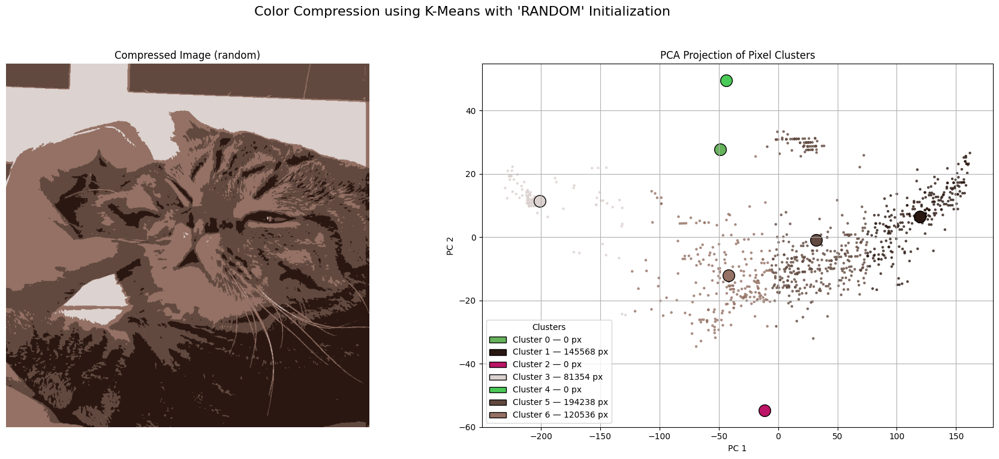


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 56
Saved comparison to 'cat_output_2_in_pixels.png'


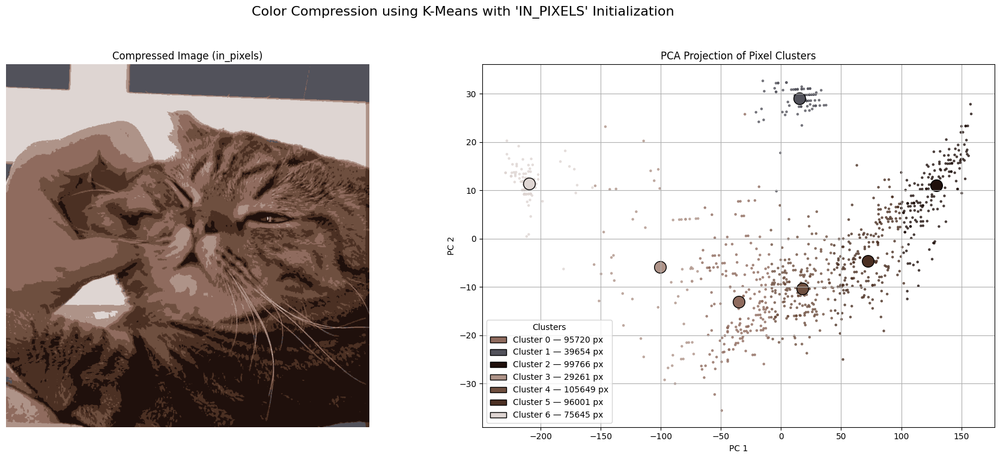


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 41
Saved comparison to 'cat_output_3_kmeans++.png'


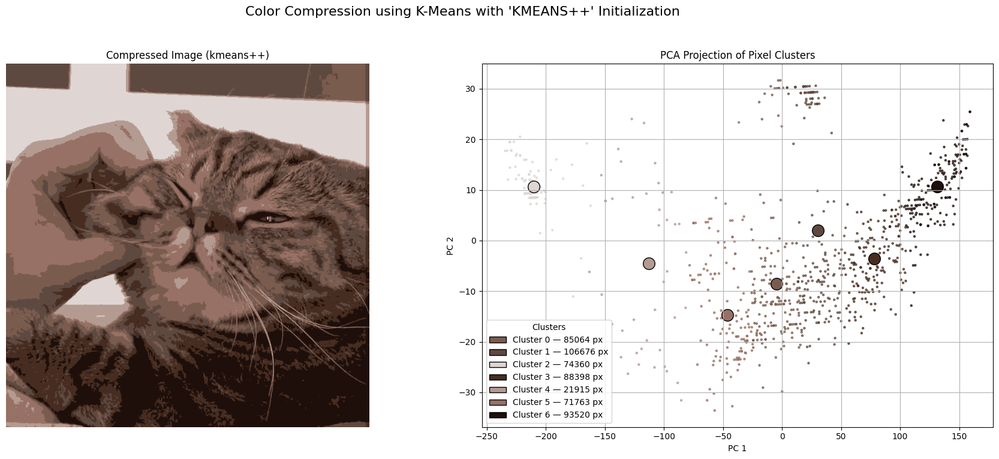


--- Processing with method: 'maximin' ---
Number of itteration with maximin 68
Saved comparison to 'cat_output_4_maximin.png'


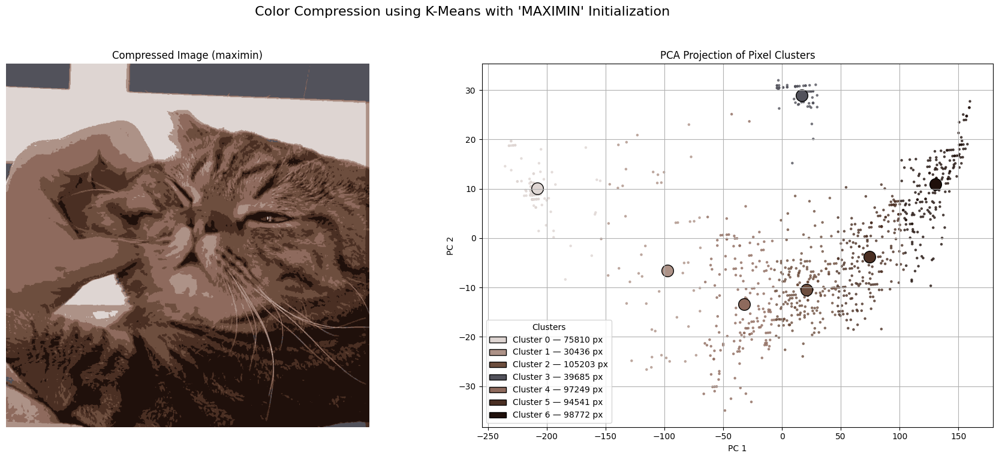


### Summary of K-Means Results:

| Init Method   |   Iterations over 100 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|----------------------:|------------------:|--------------------:|--------------------:|
| random        |                    24 |             34827 |                   7 |             4975.29 |
| in_pixels     |                    56 |             34827 |                   7 |             4975.29 |
| kmeans++      |                    41 |             34827 |                   7 |             4975.29 |
| maximin       |                    68 |             34827 |                   7 |             4975.29 |


In [12]:

test_all("assets/cat.png", k_clusters=7, max_iter=100)


Loading image: assets/flat-design.png

--- Processing with method: 'random' ---
Number of itteration with random 6
Saved comparison to 'flat-design_output_1_random.png'


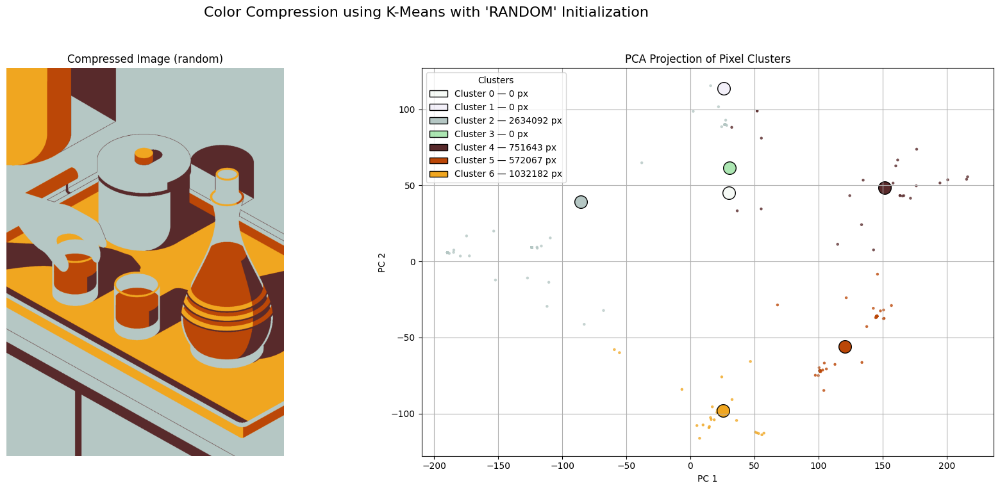


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 38
Saved comparison to 'flat-design_output_2_in_pixels.png'


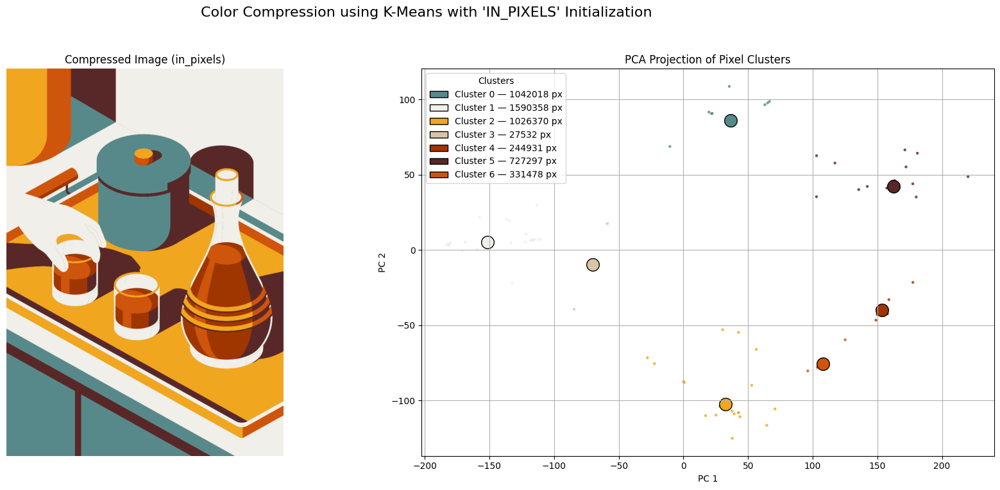


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 30
Saved comparison to 'flat-design_output_3_kmeans++.png'


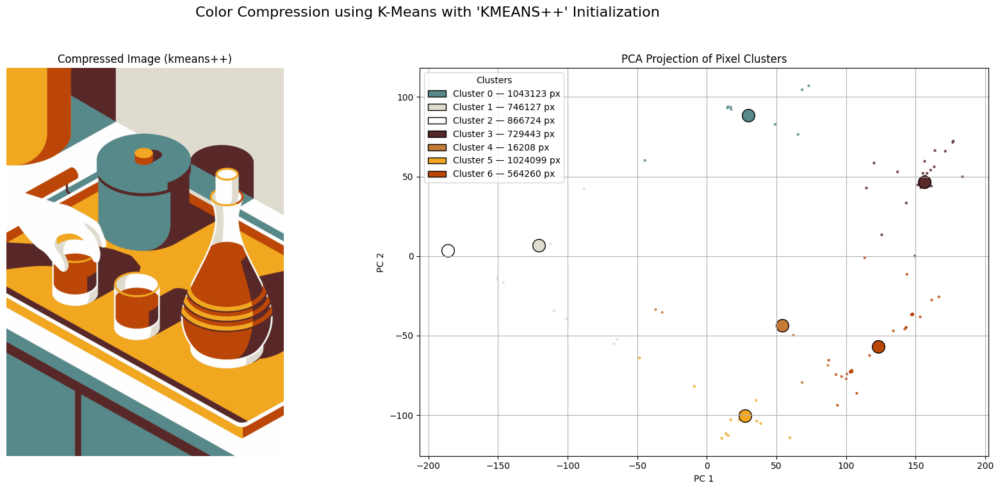


--- Processing with method: 'maximin' ---
Number of itteration with maximin 41
Saved comparison to 'flat-design_output_4_maximin.png'


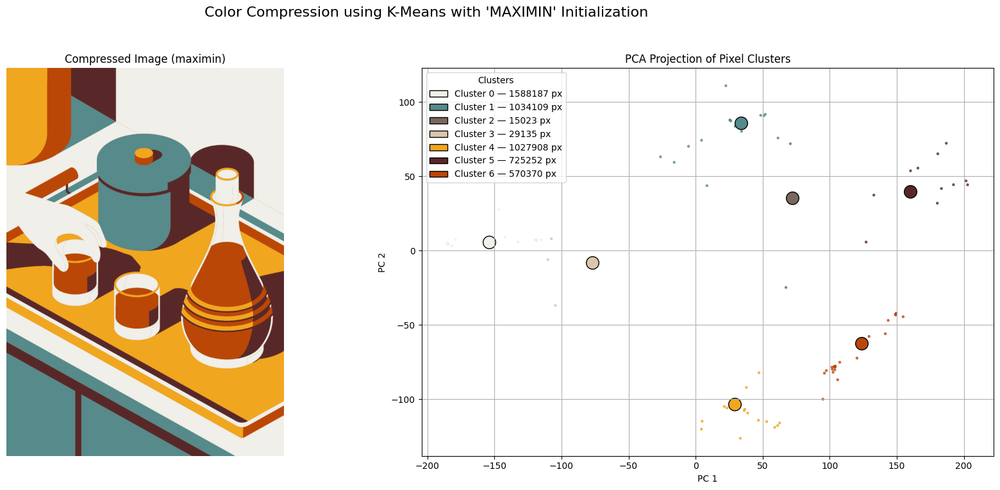


### Summary of K-Means Results:

| Init Method   |   Iterations over 100 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|----------------------:|------------------:|--------------------:|--------------------:|
| random        |                     6 |             42524 |                   7 |             6074.86 |
| in_pixels     |                    38 |             42524 |                   7 |             6074.86 |
| kmeans++      |                    30 |             42524 |                   7 |             6074.86 |
| maximin       |                    41 |             42524 |                   7 |             6074.86 |


In [13]:

test_all("assets/flat-design.png", k_clusters=7, max_iter=100)


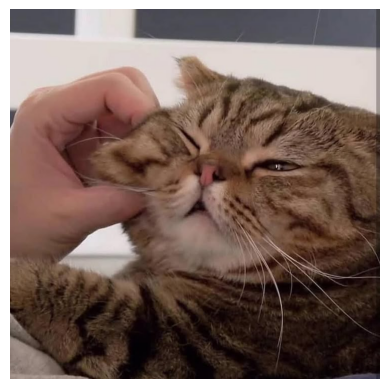

Number of itteration with maximin 68


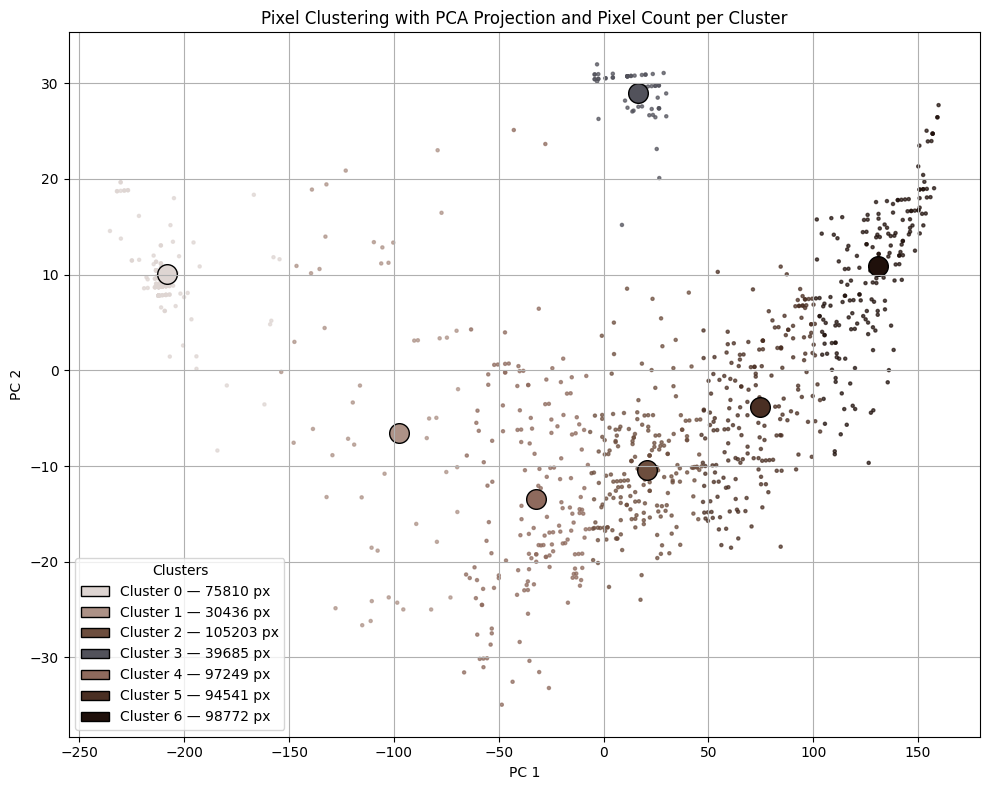

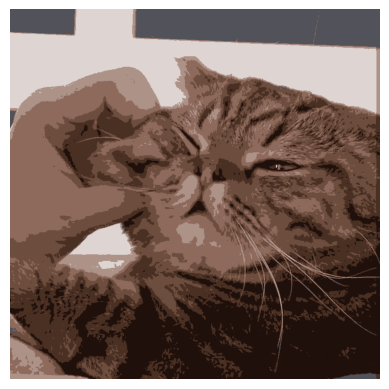

In [14]:
img = read_img("assets/cat.png")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=7, max_iter=100, init_centroids='maximin')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output.jpg")


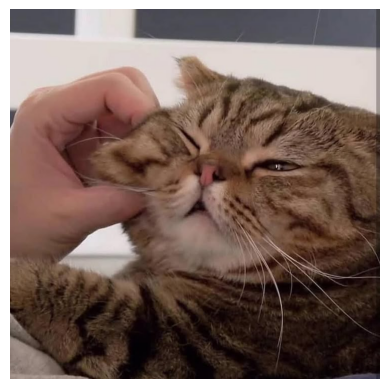

Number of itteration with kmeans++ 41


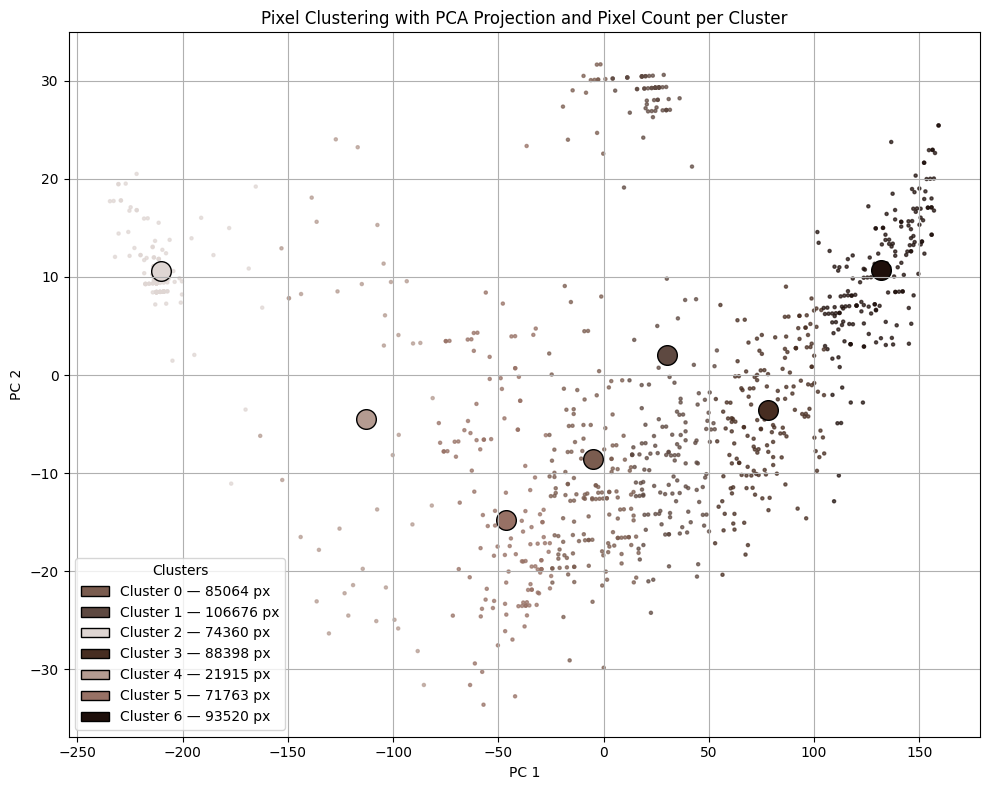

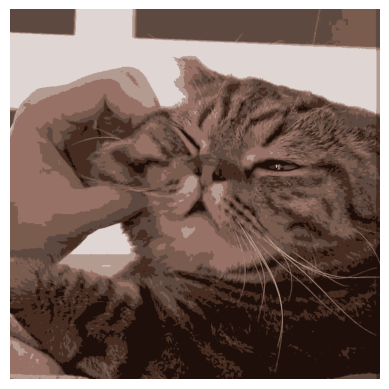

In [15]:
img = read_img("assets/cat.png")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=7, max_iter=100, init_centroids='kmeans++')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output.jpg")


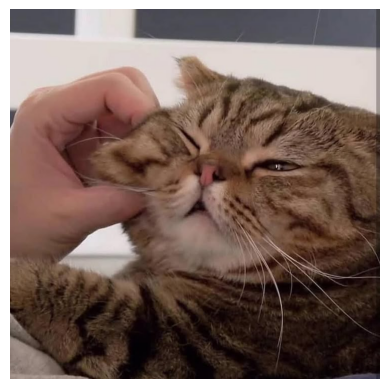

Number of itteration with random 24


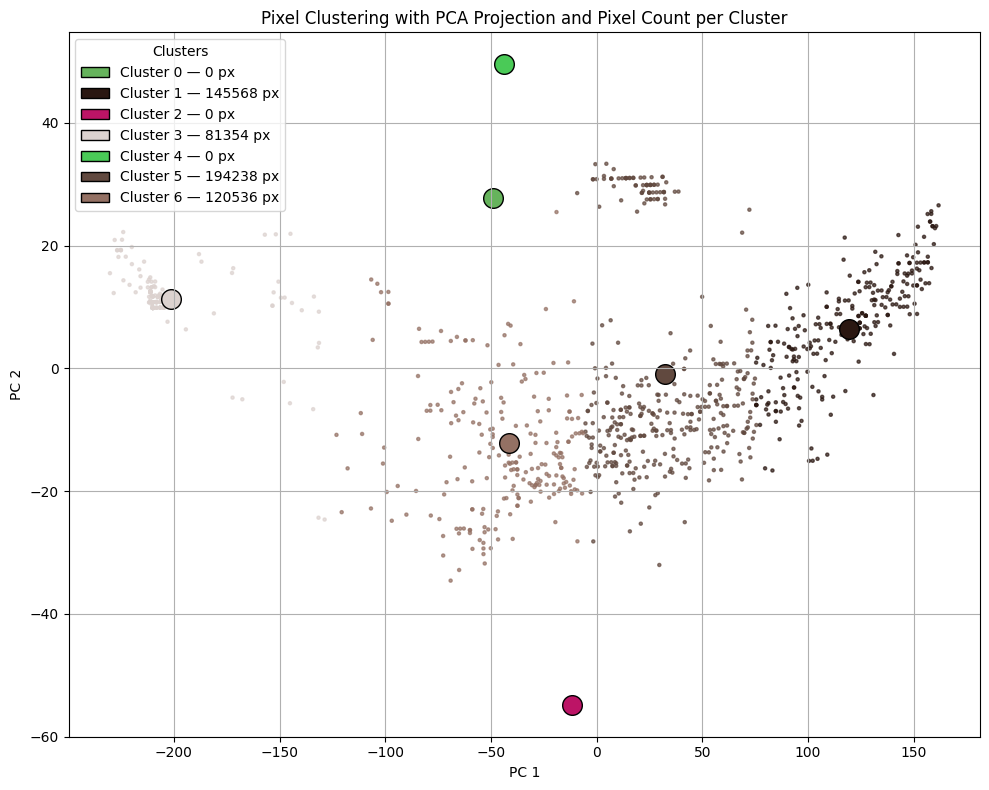

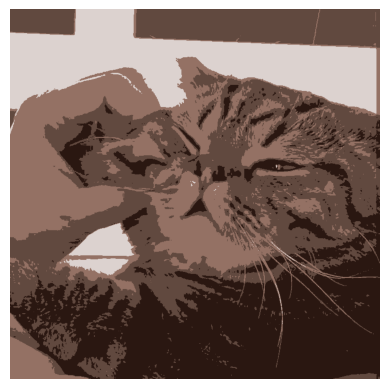

In [16]:
img = read_img("assets/cat.png")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=7, max_iter=100, init_centroids='random')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output2.jpg")


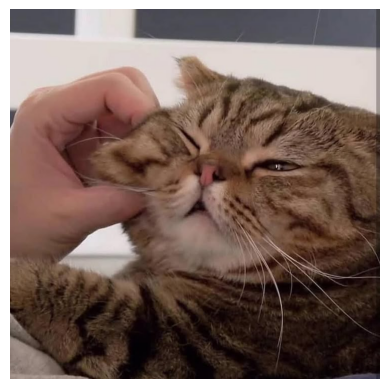

Number of itteration with in_pixels 56


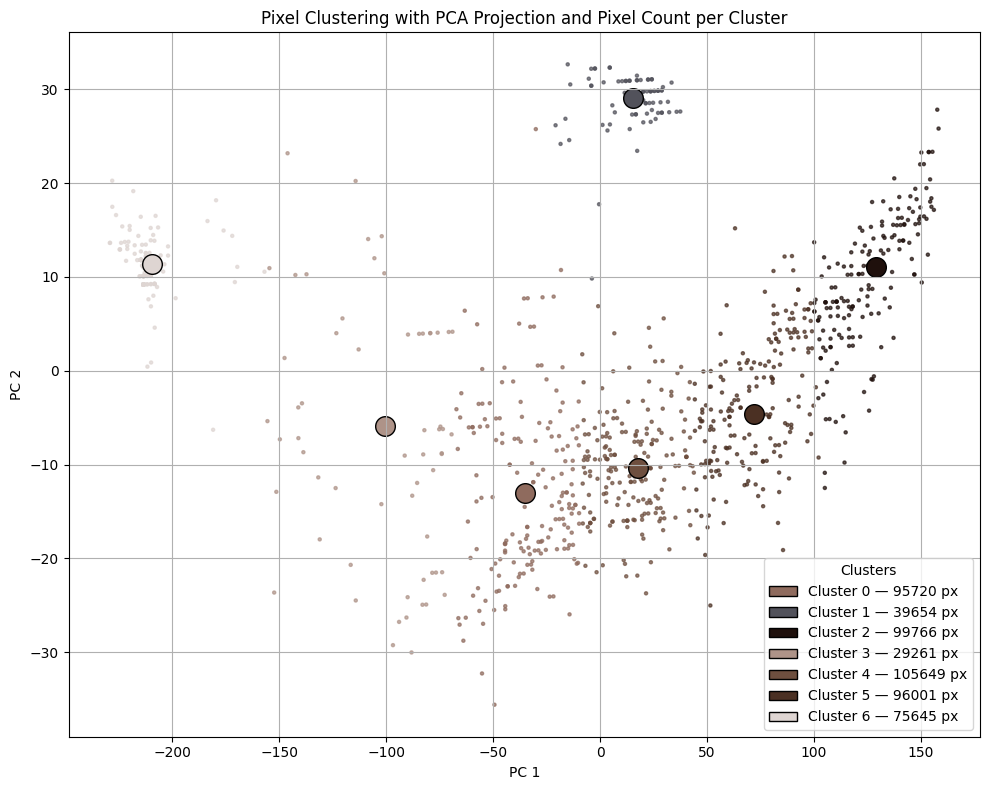

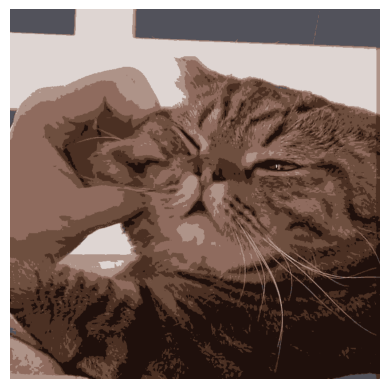

In [17]:
img = read_img("assets/cat.png")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=7, max_iter=100, init_centroids='in_pixels')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output3.jpg")


Running K-Means with k=7
Number of itteration with kmeans++ 41
Running K-Means with k=17
Number of itteration with kmeans++ 100
Running K-Means with k=27
Number of itteration with kmeans++ 100
Running K-Means with k=37
Number of itteration with kmeans++ 99
Running K-Means with k=47
Number of itteration with kmeans++ 100
Running K-Means with k=57
Number of itteration with kmeans++ 90


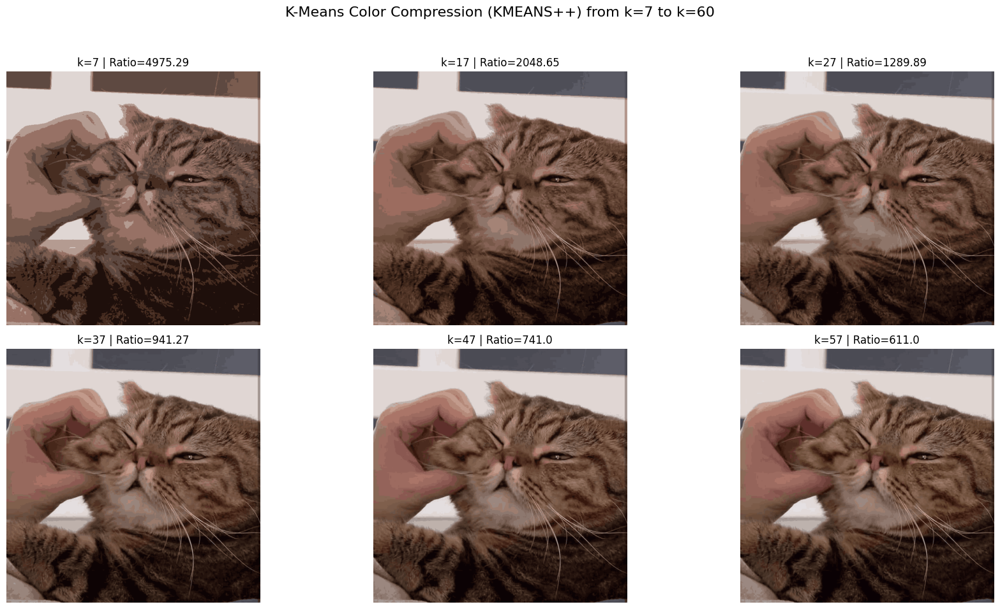


### Summary of Results:

|   k |   Original Colors |   Compressed Colors |   Compression Ratio |
|----:|------------------:|--------------------:|--------------------:|
|   7 |             34827 |                   7 |             4975.29 |
|  17 |             34827 |                  17 |             2048.65 |
|  27 |             34827 |                  27 |             1289.89 |
|  37 |             34827 |                  37 |              941.27 |
|  47 |             34827 |                  47 |              741    |
|  57 |             34827 |                  57 |              611    |


In [18]:
visualize_kmeans_range(7, 60, 10, 'assets/cat.png', init_method='kmeans++')

Loading image: assets/pexels-pixabay-147411.jpg

--- Processing with method: 'random' ---
Number of itteration with random 146
Saved comparison to 'pexels-pixabay-147411_output_1_random.png'


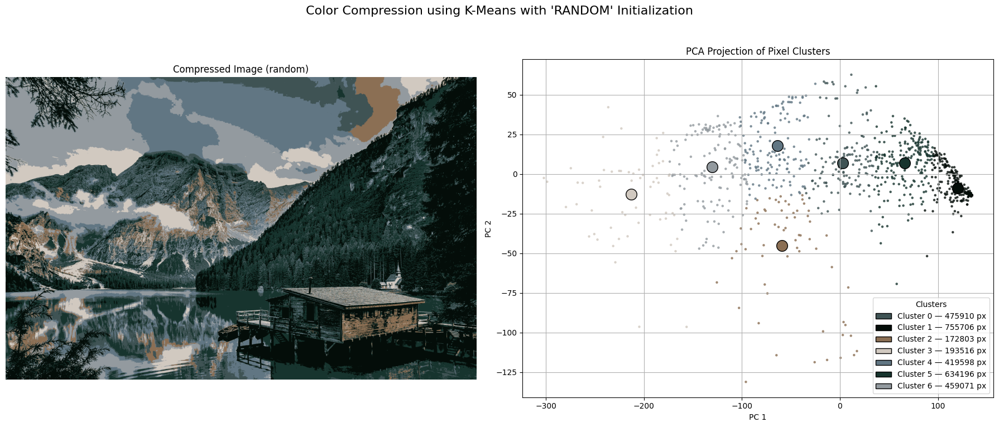


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 129
Saved comparison to 'pexels-pixabay-147411_output_2_in_pixels.png'


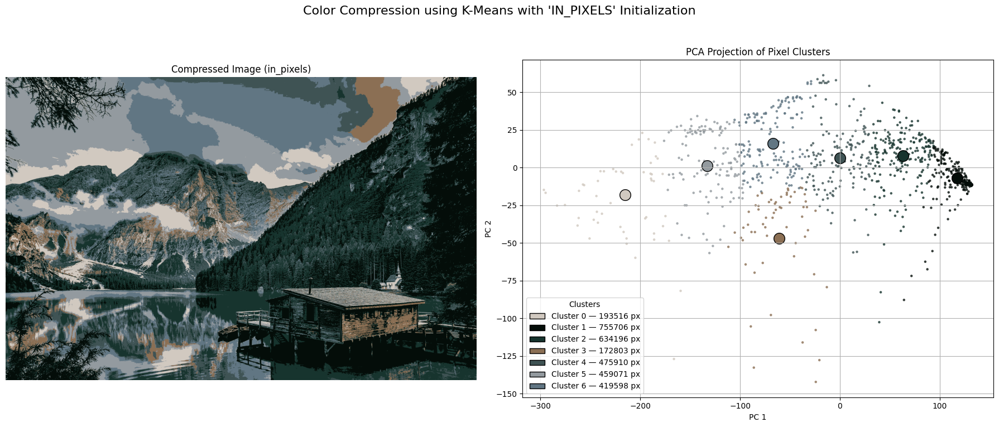


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 139
Saved comparison to 'pexels-pixabay-147411_output_3_kmeans++.png'


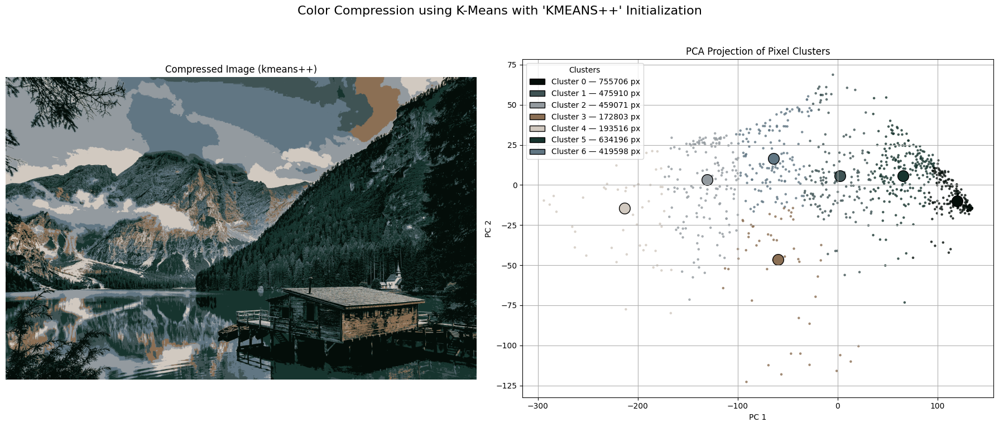


--- Processing with method: 'maximin' ---
Number of itteration with maximin 124
Saved comparison to 'pexels-pixabay-147411_output_4_maximin.png'


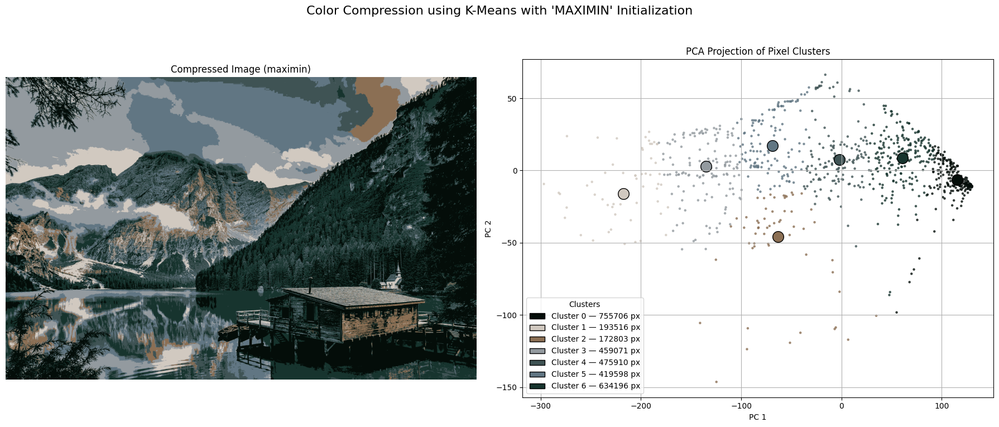


### Summary of K-Means Results:

| Init Method   |   Iterations over 300 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|----------------------:|------------------:|--------------------:|--------------------:|
| random        |                   146 |            277967 |                   7 |             39709.6 |
| in_pixels     |                   129 |            277967 |                   7 |             39709.6 |
| kmeans++      |                   139 |            277967 |                   7 |             39709.6 |
| maximin       |                   124 |            277967 |                   7 |             39709.6 |


In [26]:
test_all("assets/pexels-pixabay-147411.jpg", k_clusters=7, max_iter=300)


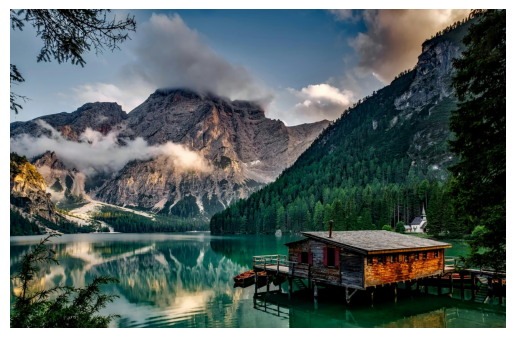

Number of itteration with in_pixels 100


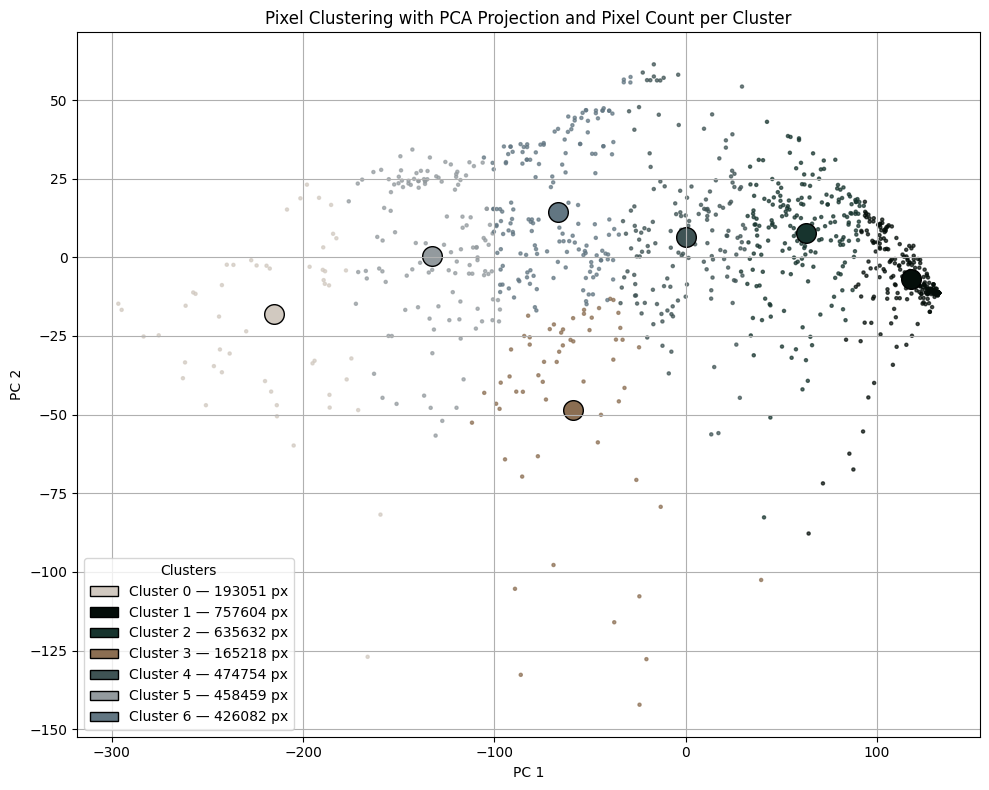

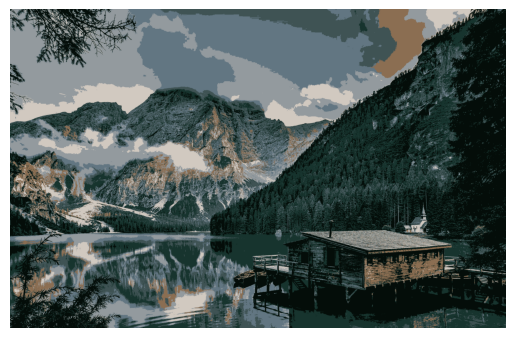

In [27]:
img = read_img("assets/pexels-pixabay-147411.jpg")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=7, max_iter=100, init_centroids='in_pixels')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output3.jpg")


Before compression


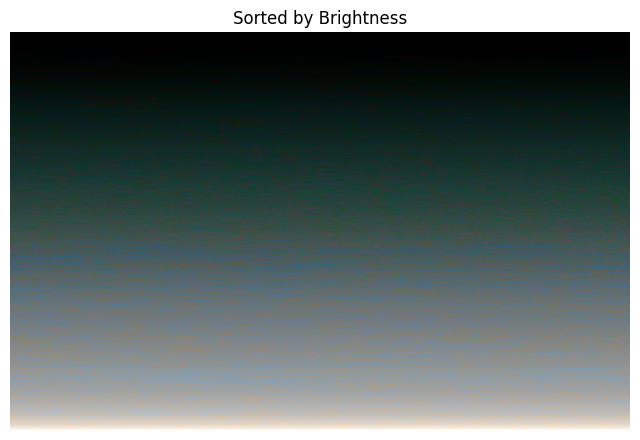

After compression


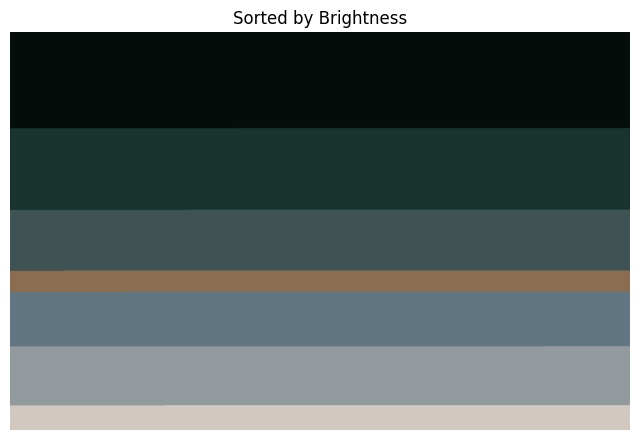

In [28]:
# Sau khi đã nén ảnh:
print("Before compression")
plot_sorted_image_by_color_distance(img_1d, np.asarray(img).shape, sort_by='luminance', title='Sorted by Brightness')

img_1d = convert_img_to_1d(new_img)
img_shape = new_img.size[1], new_img.size[0], 3  # (height, width, channels)

print("After compression")
plot_sorted_image_by_color_distance(img_1d, img_shape, sort_by='luminance', title='Sorted by Brightness')


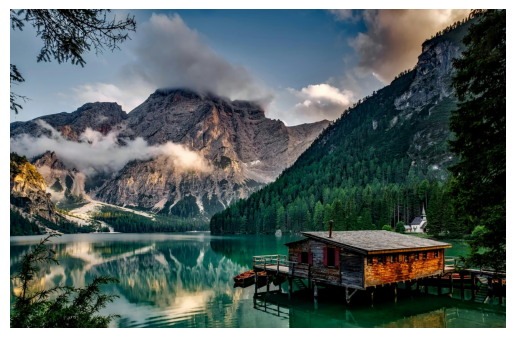

Number of itteration with in_pixels 50


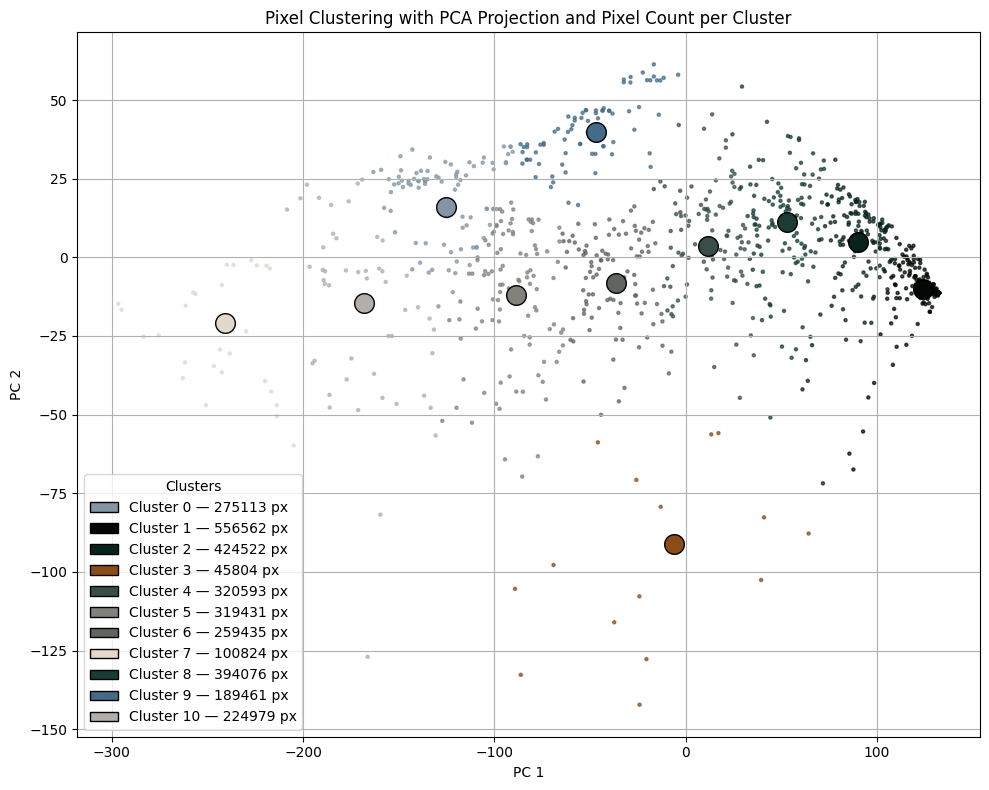

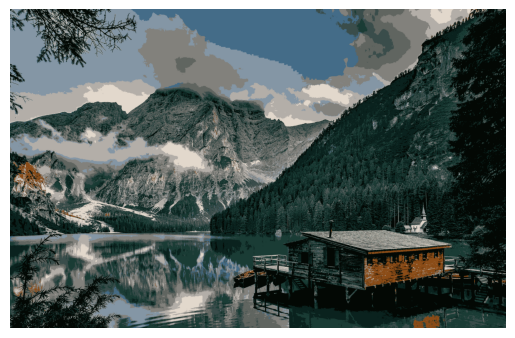

In [29]:
img = read_img("assets/pexels-pixabay-147411.jpg")
show_img(img)

img_1d = convert_img_to_1d(img)
centroids, labels = kmeans(img_1d, k_clusters=11, max_iter=50, init_centroids='in_pixels')
new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)
plot_clusters(img_1d, labels, centroids)

show_img(new_img)
save_img(new_img, "output3.jpg")


Loading image: /content/assets/pexels-pixabay-147411.jpg

--- Processing with method: 'random' ---
Number of itteration with random 42
Saved comparison to 'pexels-pixabay-147411_output_1_random.png'


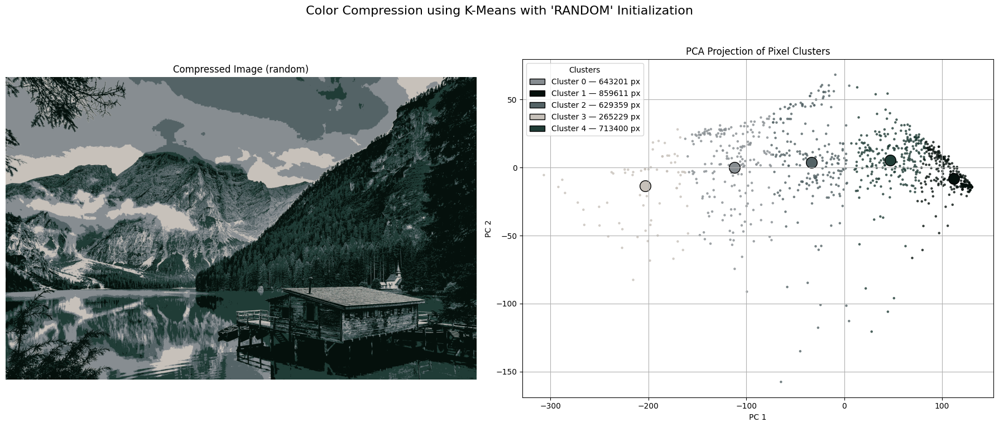


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 50
Saved comparison to 'pexels-pixabay-147411_output_2_in_pixels.png'


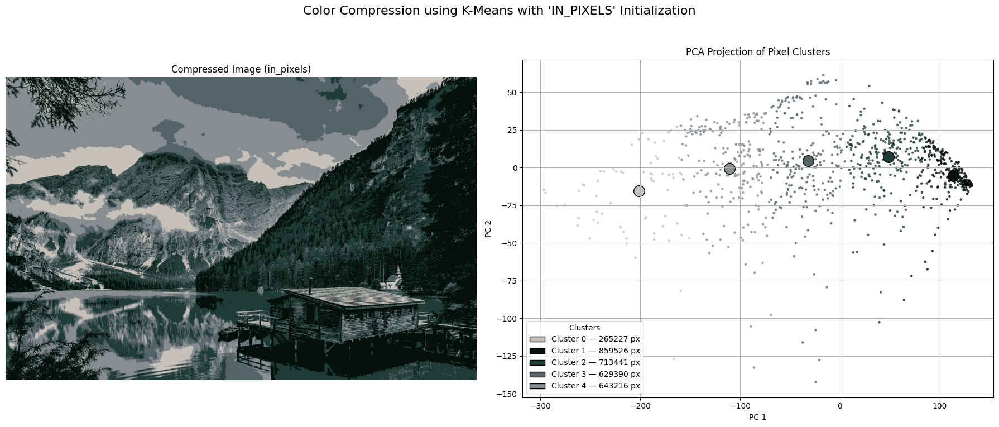


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 50
Saved comparison to 'pexels-pixabay-147411_output_3_kmeans++.png'


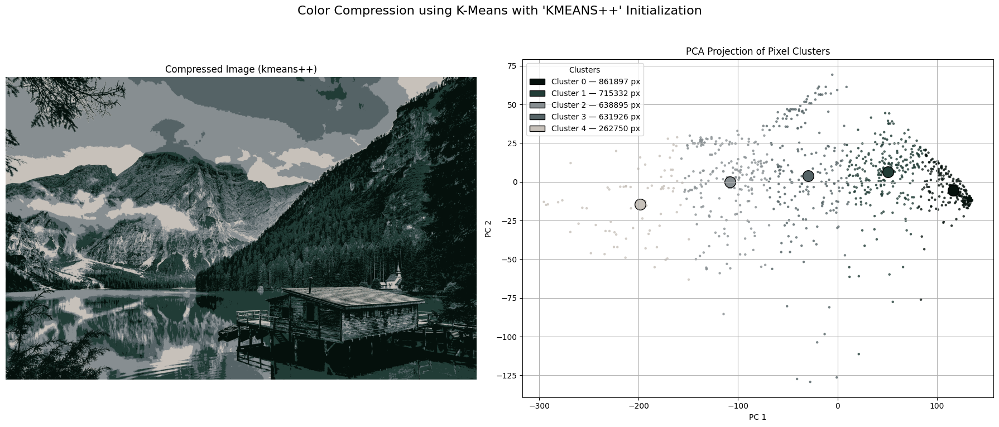


--- Processing with method: 'maximin' ---
Number of itteration with maximin 50
Saved comparison to 'pexels-pixabay-147411_output_4_maximin.png'


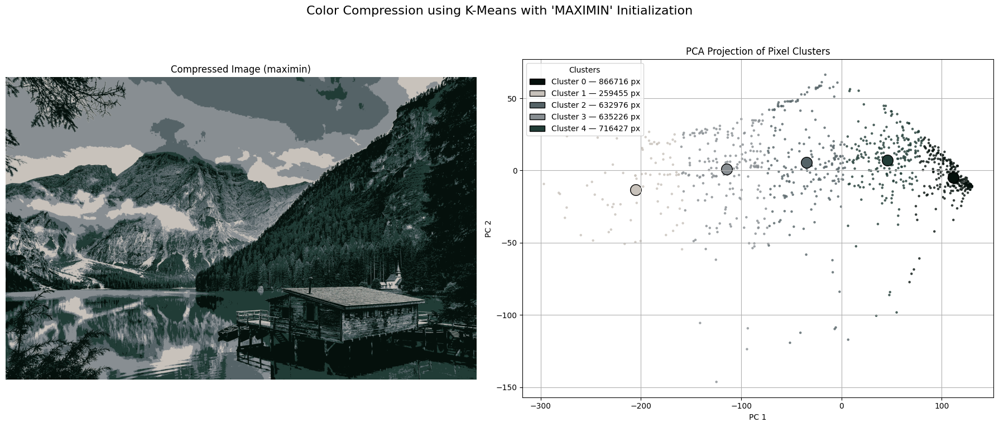


### Summary of K-Means Results:

| Init Method   |   Iterations over 50 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|---------------------:|------------------:|--------------------:|--------------------:|
| random        |                   42 |            277967 |                   5 |             55593.4 |
| in_pixels     |                   50 |            277967 |                   5 |             55593.4 |
| kmeans++      |                   50 |            277967 |                   5 |             55593.4 |
| maximin       |                   50 |            277967 |                   5 |             55593.4 |
Loading image: /content/assets/pexels-pixabay-147411.jpg

--- Processing with method: 'random' ---
Number of itteration with random 50
Saved comparison to 'pexels-pixabay-147411_output_1_random.png'


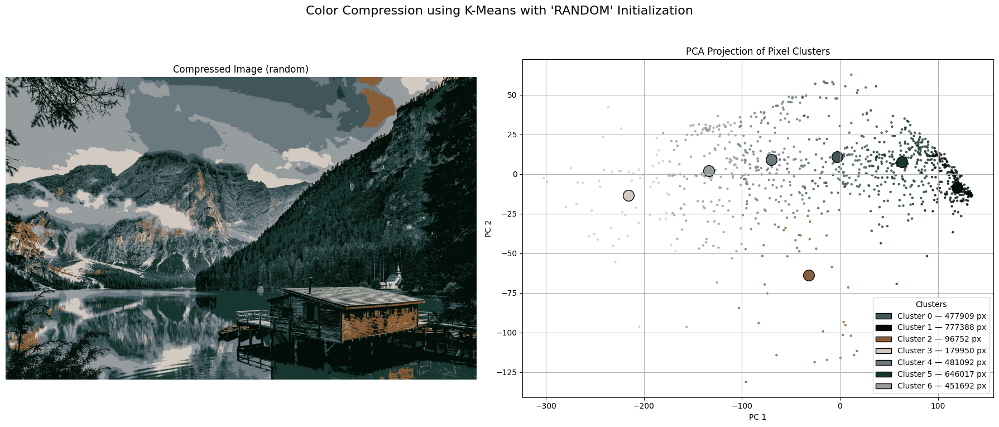


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 50
Saved comparison to 'pexels-pixabay-147411_output_2_in_pixels.png'


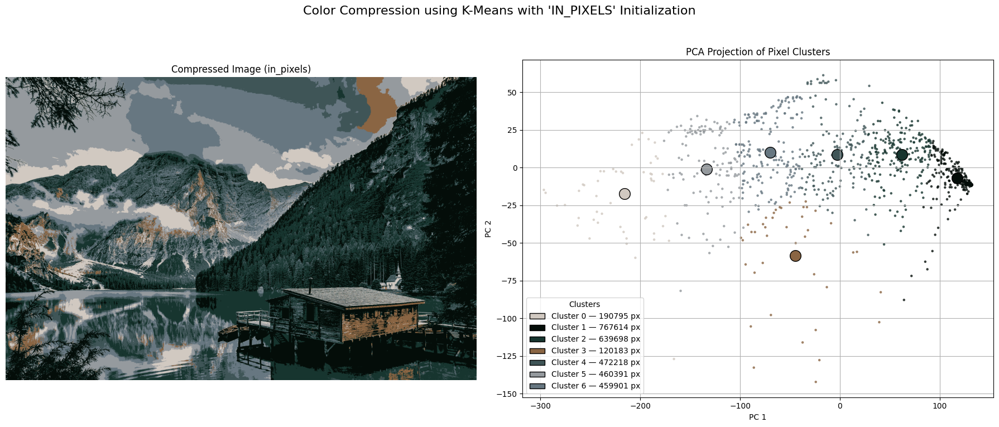


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 50
Saved comparison to 'pexels-pixabay-147411_output_3_kmeans++.png'


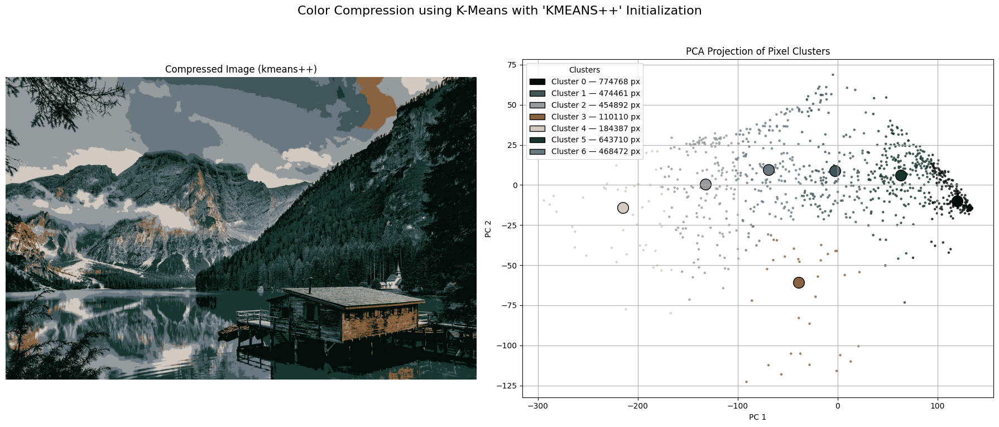


--- Processing with method: 'maximin' ---
Number of itteration with maximin 50
Saved comparison to 'pexels-pixabay-147411_output_4_maximin.png'


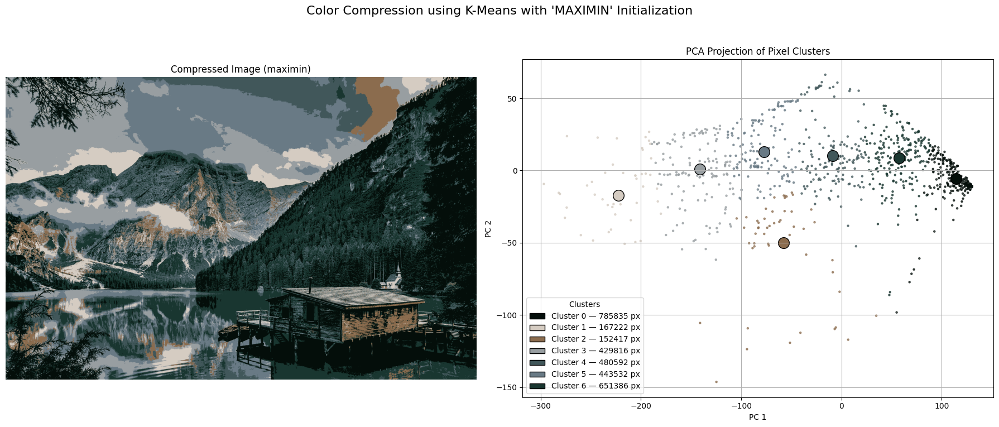


### Summary of K-Means Results:

| Init Method   |   Iterations over 50 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|---------------------:|------------------:|--------------------:|--------------------:|
| random        |                   50 |            277967 |                   7 |             39709.6 |
| in_pixels     |                   50 |            277967 |                   7 |             39709.6 |
| kmeans++      |                   50 |            277967 |                   7 |             39709.6 |
| maximin       |                   50 |            277967 |                   7 |             39709.6 |
Loading image: /content/assets/pexels-pixabay-147411.jpg

--- Processing with method: 'random' ---
Number of itteration with random 50
Saved comparison to 'pexels-pixabay-147411_output_1_random.png'


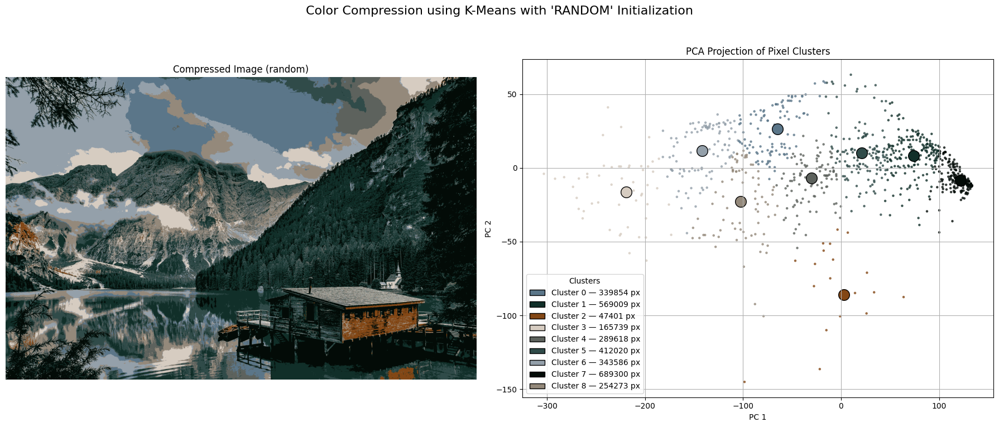


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 50
Saved comparison to 'pexels-pixabay-147411_output_2_in_pixels.png'


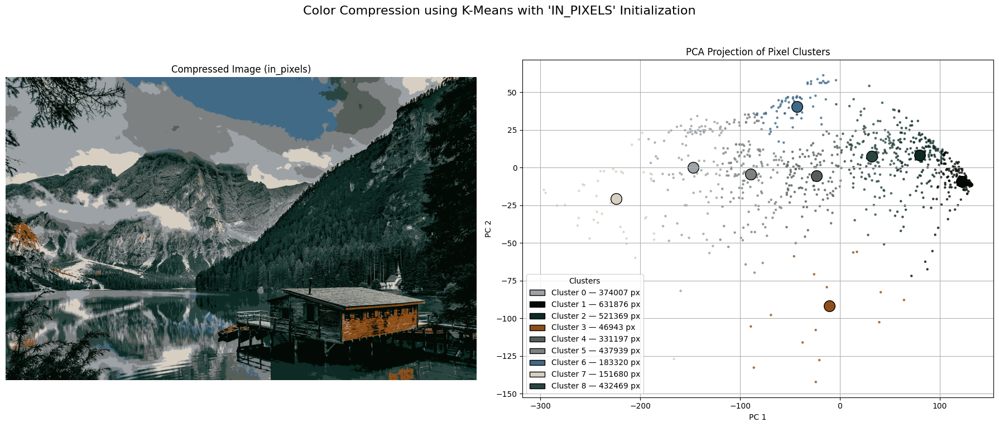


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 32
Saved comparison to 'pexels-pixabay-147411_output_3_kmeans++.png'


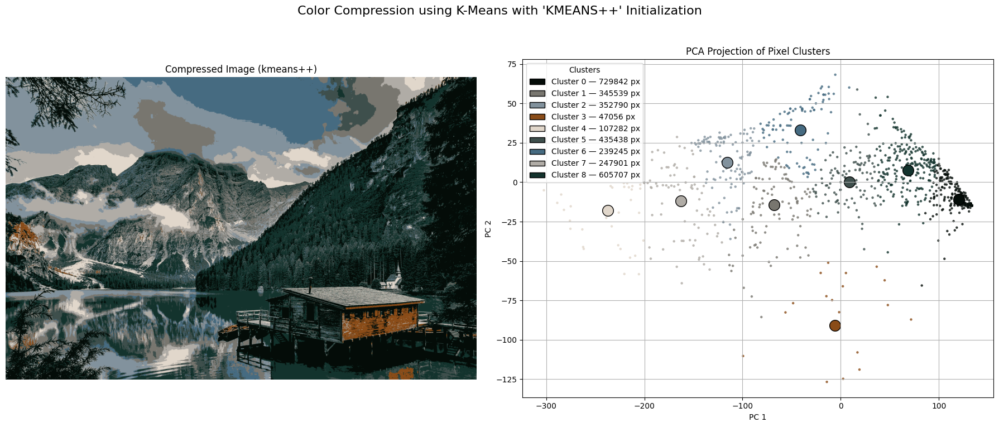


--- Processing with method: 'maximin' ---
Number of itteration with maximin 50
Saved comparison to 'pexels-pixabay-147411_output_4_maximin.png'


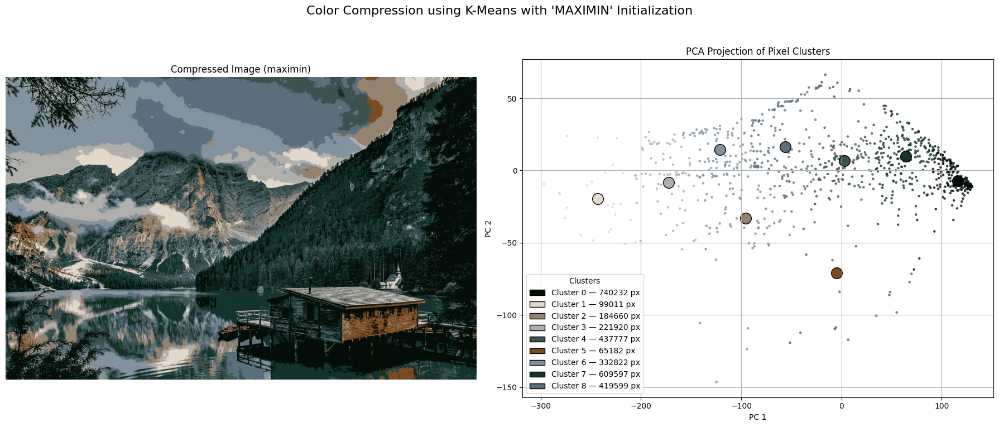


### Summary of K-Means Results:

| Init Method   |   Iterations over 50 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|---------------------:|------------------:|--------------------:|--------------------:|
| random        |                   50 |            277967 |                   9 |             30885.2 |
| in_pixels     |                   50 |            277967 |                   9 |             30885.2 |
| kmeans++      |                   32 |            277967 |                   9 |             30885.2 |
| maximin       |                   50 |            277967 |                   9 |             30885.2 |
Loading image: /content/assets/pexels-pixabay-147411.jpg

--- Processing with method: 'random' ---
Number of itteration with random 50
Saved comparison to 'pexels-pixabay-147411_output_1_random.png'


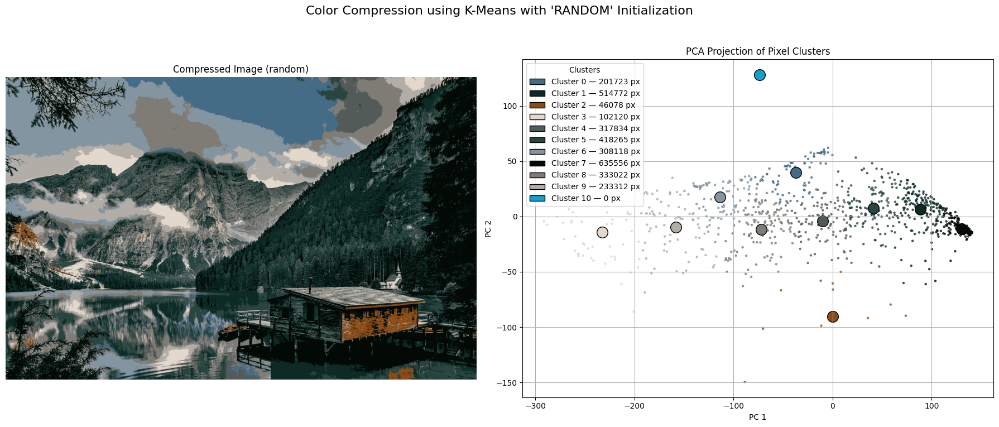


--- Processing with method: 'in_pixels' ---
Number of itteration with in_pixels 50
Saved comparison to 'pexels-pixabay-147411_output_2_in_pixels.png'


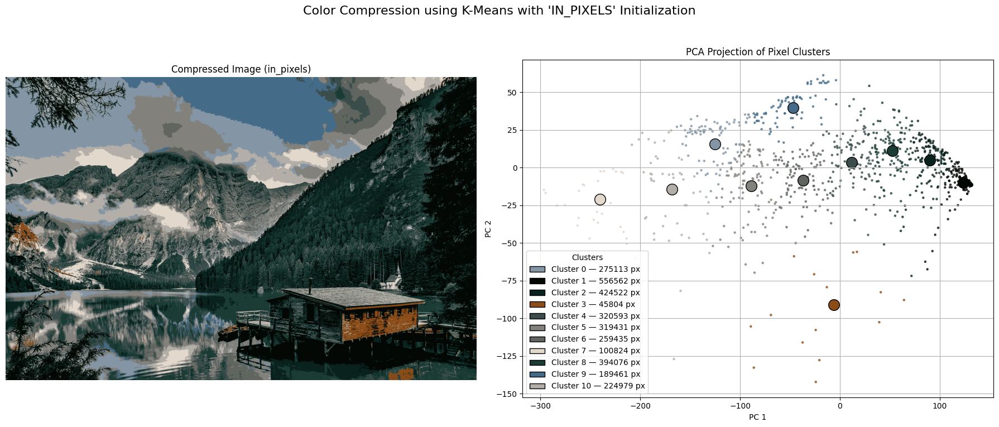


--- Processing with method: 'kmeans++' ---
Number of itteration with kmeans++ 50
Saved comparison to 'pexels-pixabay-147411_output_3_kmeans++.png'


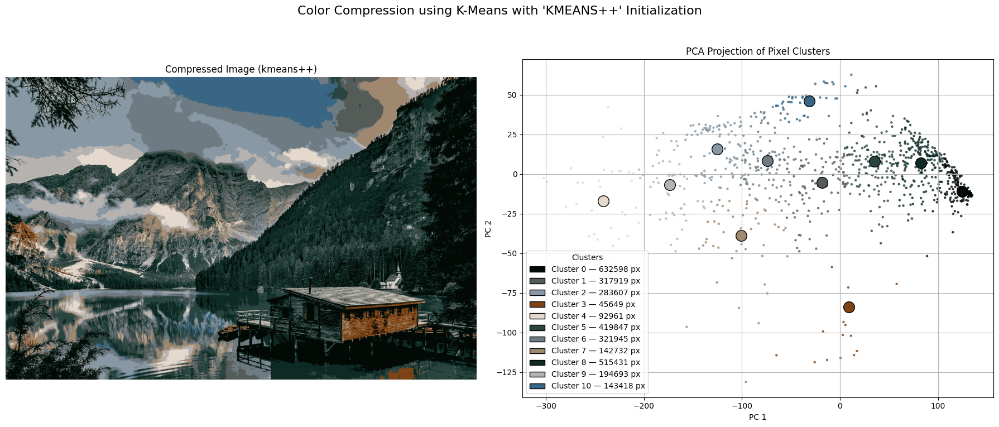


--- Processing with method: 'maximin' ---
Number of itteration with maximin 50
Saved comparison to 'pexels-pixabay-147411_output_4_maximin.png'


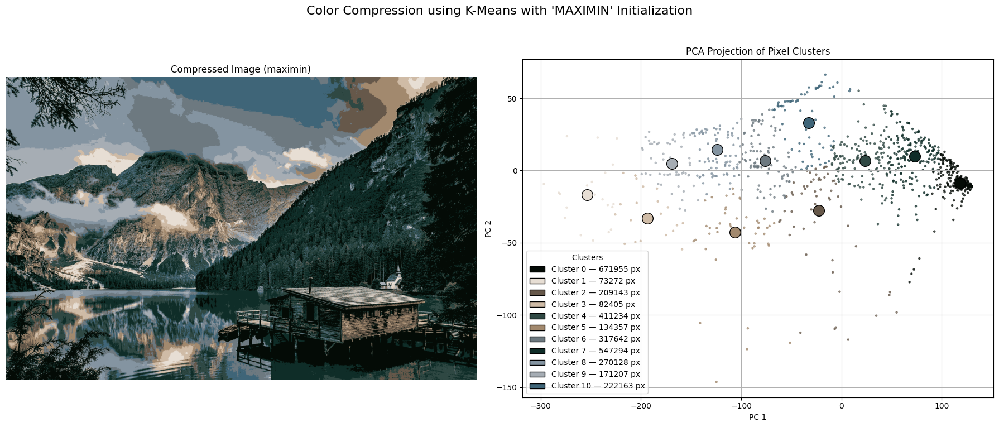


### Summary of K-Means Results:

| Init Method   |   Iterations over 50 |   Original Colors |   Compressed Colors |   Compression Ratio |
|:--------------|---------------------:|------------------:|--------------------:|--------------------:|
| random        |                   50 |            277967 |                  11 |             25269.7 |
| in_pixels     |                   50 |            277967 |                  11 |             25269.7 |
| kmeans++      |                   50 |            277967 |                  11 |             25269.7 |
| maximin       |                   50 |            277967 |                  11 |             25269.7 |


In [30]:
for k in range(5, 12, 2):
  test_all("/content/assets/landscape-resize.jpg", k_clusters=k, max_iter=50)


In [31]:


def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    """
    K-Means algorithm with convergence tracking and plotting.

    Returns:
    - centroids: final color centroids
    - labels: label for each pixel
    - deltas: list of centroid movement (distance) per iteration
    """
    np.random.seed(42)

    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    elif init_centroids == 'kmeans++':
        centroids = initialize_centroids_kmeanspp(img_1d, k_clusters)
    elif init_centroids == 'maximin':
        centroids = initialize_centroids_maximin(img_1d, k_clusters)
    else:
        raise ValueError("Unknown init_centroids method.")

    deltas = []  # Store centroid movement per iteration
    number_iter = 0

    for i in range(max_iter):
        number_iter += 1
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)

        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])

        delta = np.linalg.norm(new_centroids - centroids)
        deltas.append(delta)

        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    # Plot convergence
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o')
    plt.title(f'Convergence Plot (Init = {init_centroids})')
    plt.xlabel('Iteration')
    plt.ylabel('Centroid Shift (Δ)')
    plt.grid(True)
    plt.show()

    return centroids.astype(np.uint8), labels, deltas


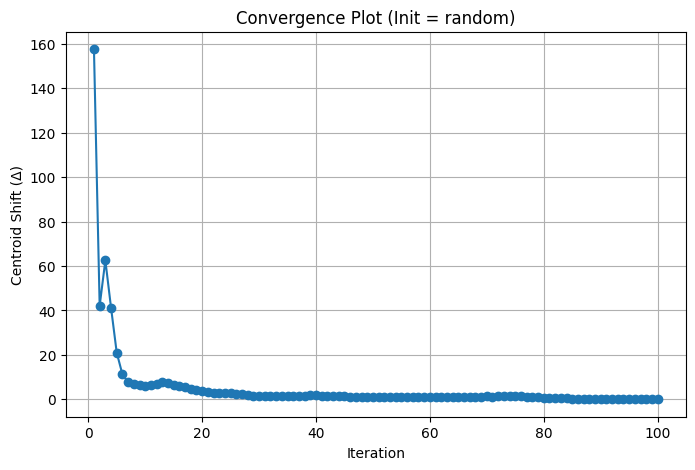

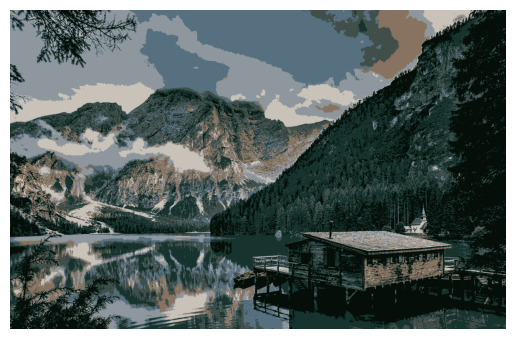

In [34]:
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
for k in range(5, 12, 2):
  centroids, labels, deltas = kmeans_with_convergence_plot(
      img_1d, k_clusters=k, max_iter=100, init_centroids='random'
  )

  new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

  show_img(new_img)


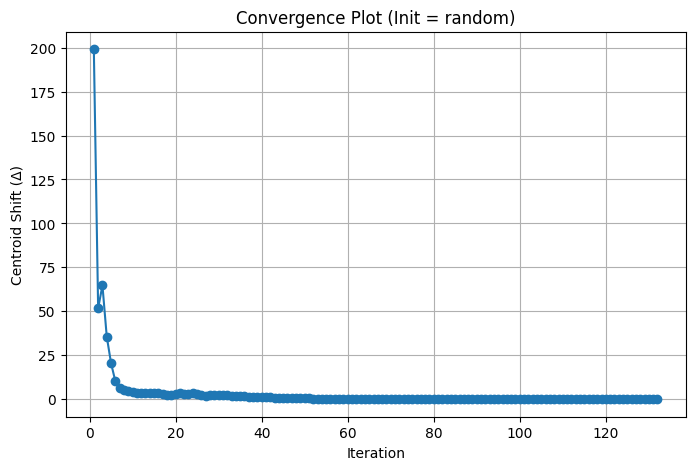

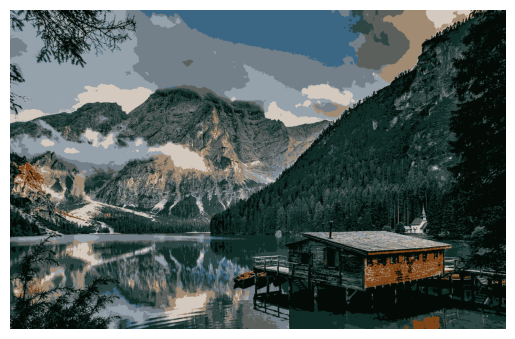

In [35]:
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)

centroids, labels, deltas = kmeans_with_convergence_plot(
    img_1d, k_clusters=11, max_iter=200, init_centroids='random'
)

new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

show_img(new_img)


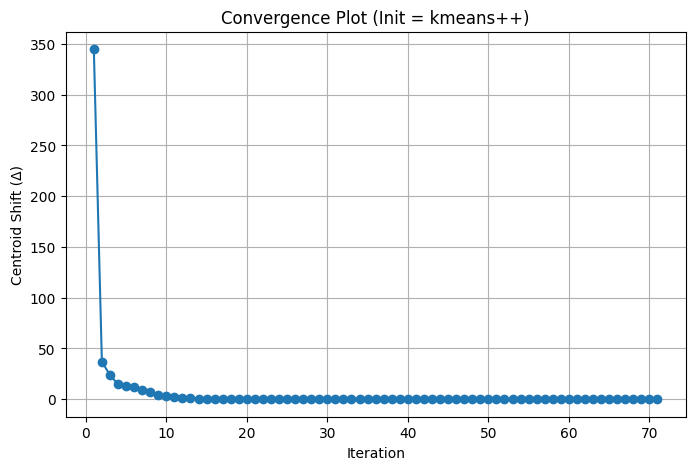

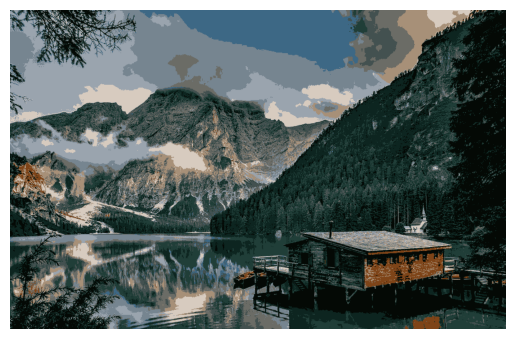

In [36]:
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)

centroids, labels, deltas = kmeans_with_convergence_plot(
    img_1d, k_clusters=11, max_iter=200, init_centroids='kmeans++'
)

new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

show_img(new_img)


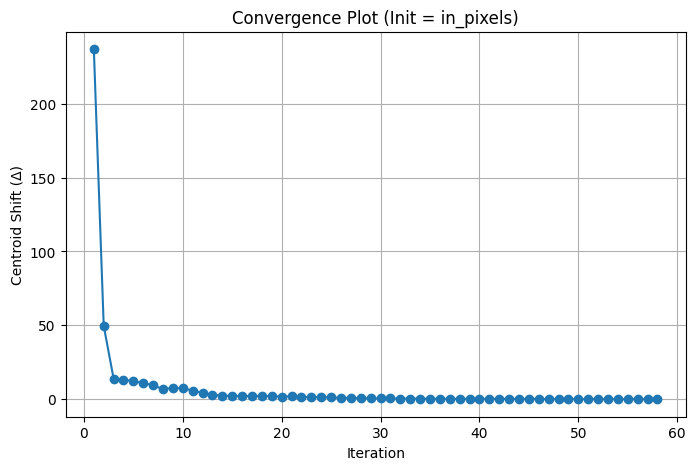

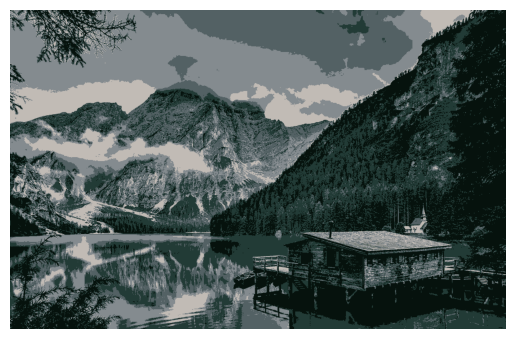

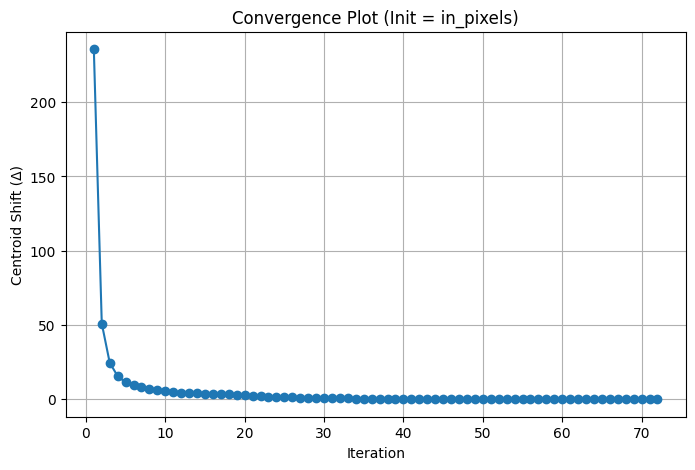

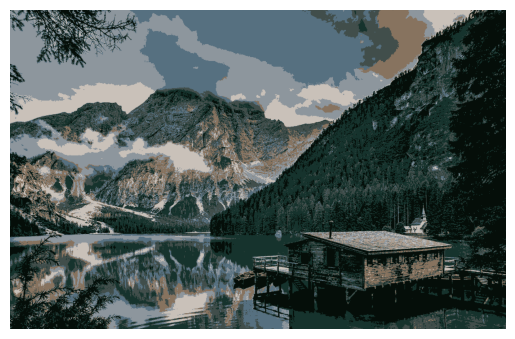

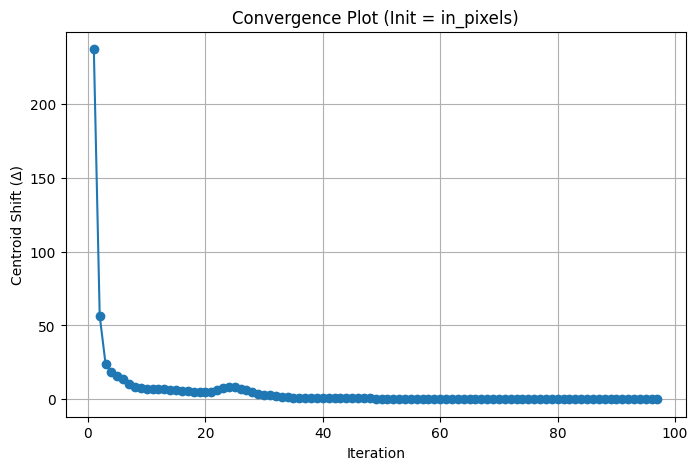

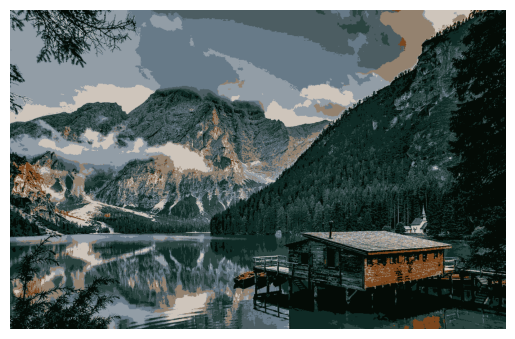

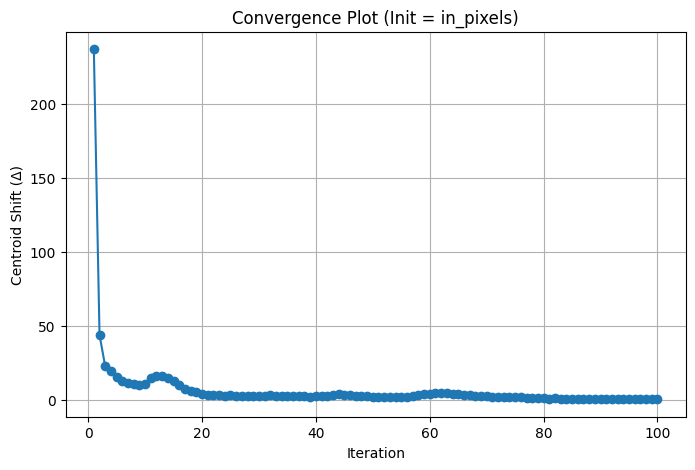

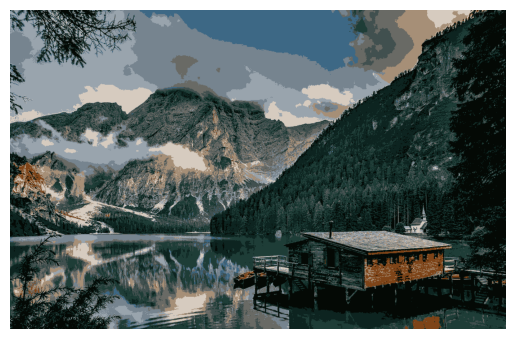

In [42]:
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
for k in range(5, 12, 2):
  centroids, labels, deltas = kmeans_with_convergence_plot(
      img_1d, k_clusters=k, max_iter=100, init_centroids='in_pixels'
  )

  new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

  show_img(new_img)


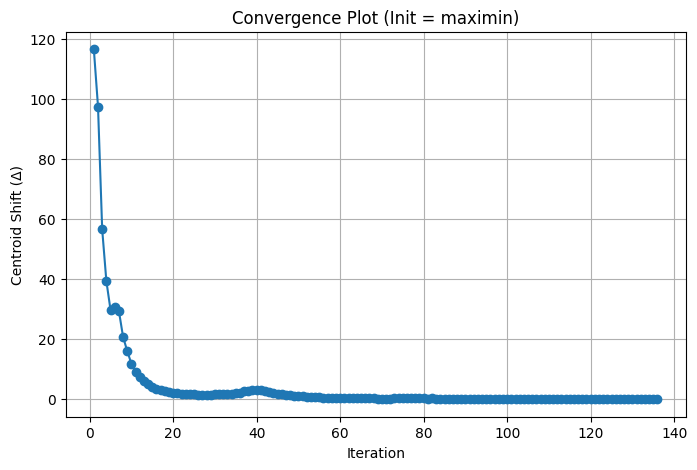

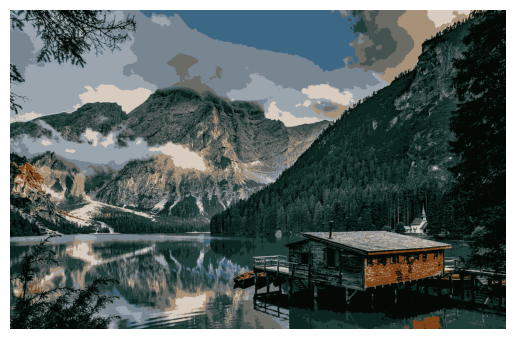

In [38]:
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)

centroids, labels, deltas = kmeans_with_convergence_plot(
    img_1d, k_clusters=11, max_iter=200, init_centroids='maximin'
)

new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

show_img(new_img)


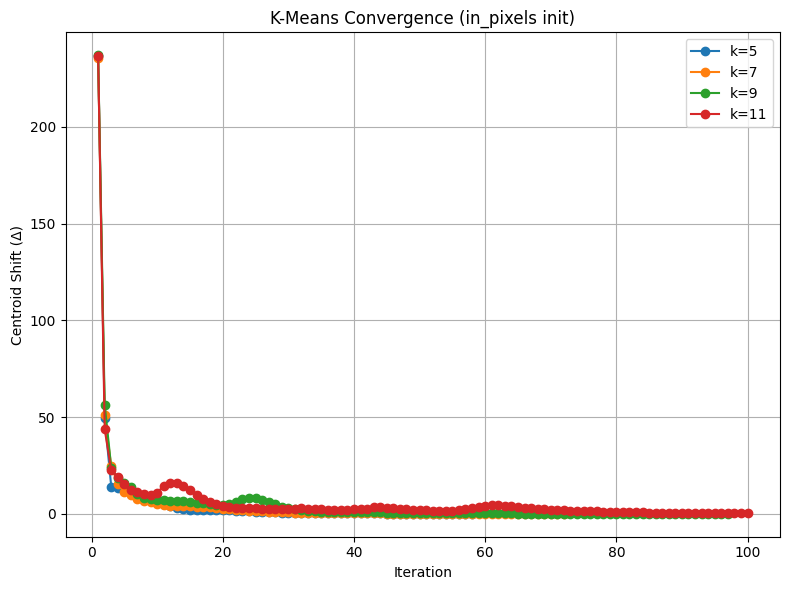

In [43]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# --- K-Means with convergence tracking ---
def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    np.random.seed(42)

    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    else:
        raise ValueError("init_centroids must be 'random' or 'in_pixels'")

    deltas = []
    for _ in range(max_iter):
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])
        delta = np.linalg.norm(centroids - new_centroids)
        deltas.append(delta)
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    return centroids.astype(np.uint8), labels, deltas

# --- Image utility functions ---
def read_img(img_path):
    return Image.open(img_path)

def convert_img_to_1d(img_2d):
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)

def generate_2d_img(img_2d_shape, centroids, labels):
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))

def concat_images_horizontally(image_tuples):
    widths, heights = zip(*(img.size for _, img in image_tuples))
    total_width = sum(widths)
    max_height = max(heights)
    result = Image.new('RGB', (total_width, max_height))
    x_offset = 0
    for k, img in image_tuples:
        result.paste(img, (x_offset, 0))
        x_offset += img.size[0]
    return result

# --- Run experiment for multiple k values ---
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
img_shape = np.asarray(img).shape

all_deltas = {}
result_images = []

for k in range(5, 12, 2):  # k = 5, 7, 9, 11
    centroids, labels, deltas = kmeans_with_convergence_plot(
        img_1d, k_clusters=k, max_iter=100, init_centroids='in_pixels'
    )
    all_deltas[k] = deltas
    new_img = generate_2d_img(img_shape, centroids, labels)
    result_images.append((k, new_img))

# --- Plot all convergence curves ---
plt.figure(figsize=(8, 6))
for k, deltas in all_deltas.items():
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o', label=f'k={k}')
plt.title('K-Means Convergence (in_pixels init)')
plt.xlabel('Iteration')
plt.ylabel('Centroid Shift (Δ)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Show combined image of all results ---
combined_img = concat_images_horizontally(result_images)
combined_img.show()
# Optionally save:
# combined_img.save("comparison_kmeans_results.png")


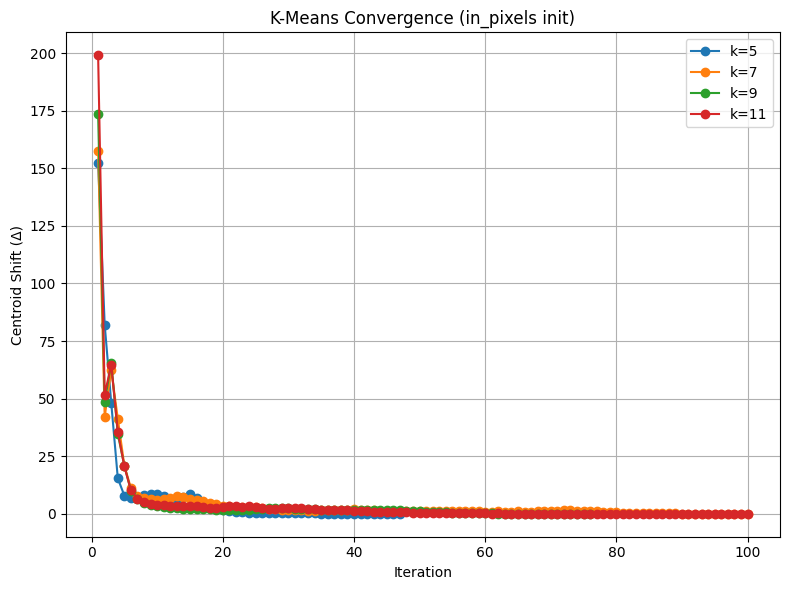

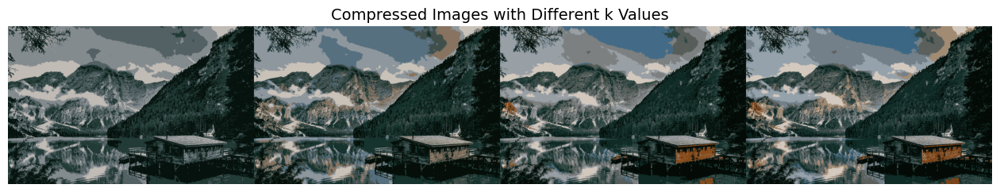

In [45]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# --- K-Means with convergence tracking ---
def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    np.random.seed(42)

    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    else:
        raise ValueError("init_centroids must be 'random' or 'in_pixels'")

    deltas = []
    for _ in range(max_iter):
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])
        delta = np.linalg.norm(centroids - new_centroids)
        deltas.append(delta)
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    return centroids.astype(np.uint8), labels, deltas

# --- Image utility functions ---
def read_img(img_path):
    return Image.open(img_path)

def convert_img_to_1d(img_2d):
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)

def generate_2d_img(img_2d_shape, centroids, labels):
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))

def concat_images_horizontally(image_tuples):
    widths, heights = zip(*(img.size for _, img in image_tuples))
    total_width = sum(widths)
    max_height = max(heights)
    result = Image.new('RGB', (total_width, max_height))
    x_offset = 0
    for k, img in image_tuples:
        result.paste(img, (x_offset, 0))
        x_offset += img.size[0]
    return result

# --- Run experiment for multiple k values ---
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
img_shape = np.asarray(img).shape

all_deltas = {}
result_images = []

for k in range(5, 12, 2):  # k = 5, 7, 9, 11
    centroids, labels, deltas = kmeans_with_convergence_plot(
        img_1d, k_clusters=k, max_iter=100, init_centroids='random'
    )
    all_deltas[k] = deltas
    new_img = generate_2d_img(img_shape, centroids, labels)
    result_images.append((k, new_img))

# --- Plot all convergence curves ---
plt.figure(figsize=(8, 6))
for k, deltas in all_deltas.items():
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o', label=f'k={k}')
plt.title('K-Means Convergence (in_pixels init)')
plt.xlabel('Iteration')
plt.ylabel('Centroid Shift (Δ)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Show combined image of all results ---
combined_img = concat_images_horizontally(result_images)
# --- Show combined image of all results using matplotlib ---
plt.figure(figsize=(16, 8))
plt.imshow(combined_img)
plt.axis('off')
plt.title("Compressed Images with Different k Values", fontsize=14)
plt.show()

# Optional: Save to file
# combined_img.save("comparison_kmeans_results.png")

# Optionally save:
# combined_img.save("comparison_kmeans_results.png")


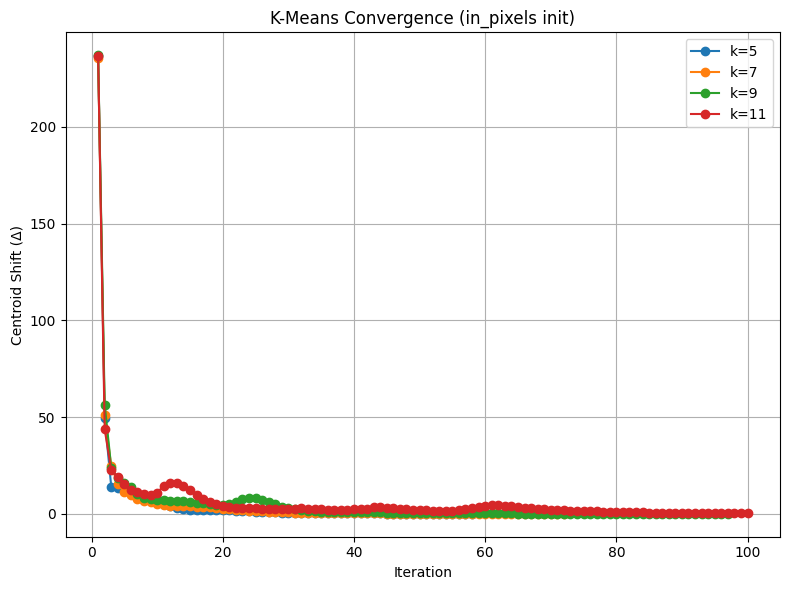

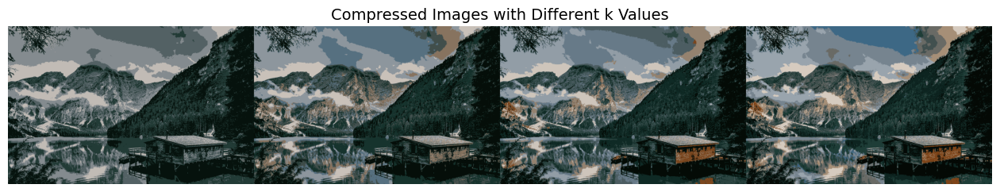

In [47]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# --- K-Means with convergence tracking ---
def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    np.random.seed(42)

    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    else:
        raise ValueError("init_centroids must be 'random' or 'in_pixels'")

    deltas = []
    for _ in range(max_iter):
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])
        delta = np.linalg.norm(centroids - new_centroids)
        deltas.append(delta)
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    return centroids.astype(np.uint8), labels, deltas

# --- Image utility functions ---
def read_img(img_path):
    return Image.open(img_path)

def convert_img_to_1d(img_2d):
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)

def generate_2d_img(img_2d_shape, centroids, labels):
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))

def concat_images_horizontally(image_tuples):
    widths, heights = zip(*(img.size for _, img in image_tuples))
    total_width = sum(widths)
    max_height = max(heights)
    result = Image.new('RGB', (total_width, max_height))
    x_offset = 0
    for k, img in image_tuples:
        result.paste(img, (x_offset, 0))
        x_offset += img.size[0]
    return result

# --- Run experiment for multiple k values ---
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
img_shape = np.asarray(img).shape

all_deltas = {}
result_images = []

for k in range(5, 12, 2):  # k = 5, 7, 9, 11
    centroids, labels, deltas = kmeans_with_convergence_plot(
        img_1d, k_clusters=k, max_iter=100, init_centroids='in_pixels'
    )
    all_deltas[k] = deltas
    new_img = generate_2d_img(img_shape, centroids, labels)
    result_images.append((k, new_img))

# --- Plot all convergence curves ---
plt.figure(figsize=(8, 6))
for k, deltas in all_deltas.items():
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o', label=f'k={k}')
plt.title('K-Means Convergence (in_pixels init)')
plt.xlabel('Iteration')
plt.ylabel('Centroid Shift (Δ)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Show combined image of all results ---
combined_img = concat_images_horizontally(result_images)
# --- Show combined image of all results using matplotlib ---
plt.figure(figsize=(16, 8))
plt.imshow(combined_img)
plt.axis('off')
plt.title("Compressed Images with Different k Values", fontsize=14)
plt.show()

# Optional: Save to file
# combined_img.save("comparison_kmeans_results.png")

# Optionally save:
# combined_img.save("comparison_kmeans_results.png")


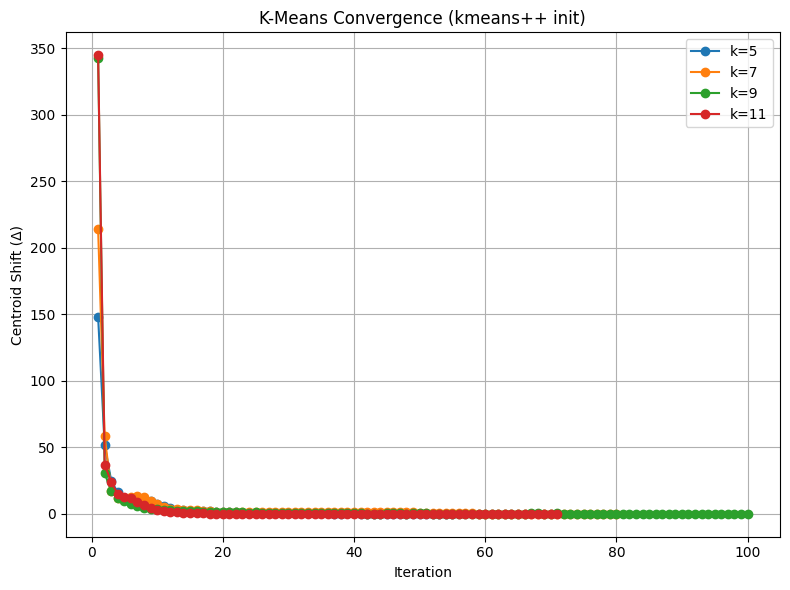

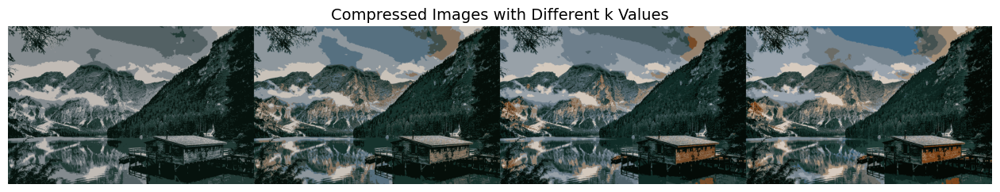

In [53]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# --- K-Means with convergence tracking ---
def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    np.random.seed(42)



    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    elif init_centroids == 'kmeans++':
        centroids = initialize_centroids_kmeanspp(img_1d, k_clusters)
    elif init_centroids == 'maximin':
        centroids = initialize_centroids_maximin(img_1d, k_clusters)
    else:
        raise ValueError("Unknown init_centroids method.")

    deltas = []
    for _ in range(max_iter):
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])
        delta = np.linalg.norm(centroids - new_centroids)
        deltas.append(delta)
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    return centroids.astype(np.uint8), labels, deltas

# --- Image utility functions ---
def read_img(img_path):
    return Image.open(img_path)

def convert_img_to_1d(img_2d):
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)

def generate_2d_img(img_2d_shape, centroids, labels):
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))

def concat_images_horizontally(image_tuples):
    widths, heights = zip(*(img.size for _, img in image_tuples))
    total_width = sum(widths)
    max_height = max(heights)
    result = Image.new('RGB', (total_width, max_height))
    x_offset = 0
    for k, img in image_tuples:
        result.paste(img, (x_offset, 0))
        x_offset += img.size[0]
    return result

# --- Run experiment for multiple k values ---
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
img_shape = np.asarray(img).shape

all_deltas = {}
result_images = []

for k in range(5, 12, 2):  # k = 5, 7, 9, 11
    centroids, labels, deltas = kmeans_with_convergence_plot(
        img_1d, k_clusters=k, max_iter=100, init_centroids='kmeans++'
    )
    all_deltas[k] = deltas
    new_img = generate_2d_img(img_shape, centroids, labels)
    result_images.append((k, new_img))

# --- Plot all convergence curves ---
plt.figure(figsize=(8, 6))
for k, deltas in all_deltas.items():
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o', label=f'k={k}')
plt.title('K-Means Convergence (kmeans++ init)')
plt.xlabel('Iteration')
plt.ylabel('Centroid Shift (Δ)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Show combined image of all results ---
combined_img = concat_images_horizontally(result_images)
# --- Show combined image of all results using matplotlib ---
plt.figure(figsize=(16, 8))
plt.imshow(combined_img)
plt.axis('off')
plt.title("Compressed Images with Different k Values", fontsize=14)
plt.show()

# Optional: Save to file
# combined_img.save("comparison_kmeans_results.png")

# Optionally save:
# combined_img.save("comparison_kmeans_results.png")


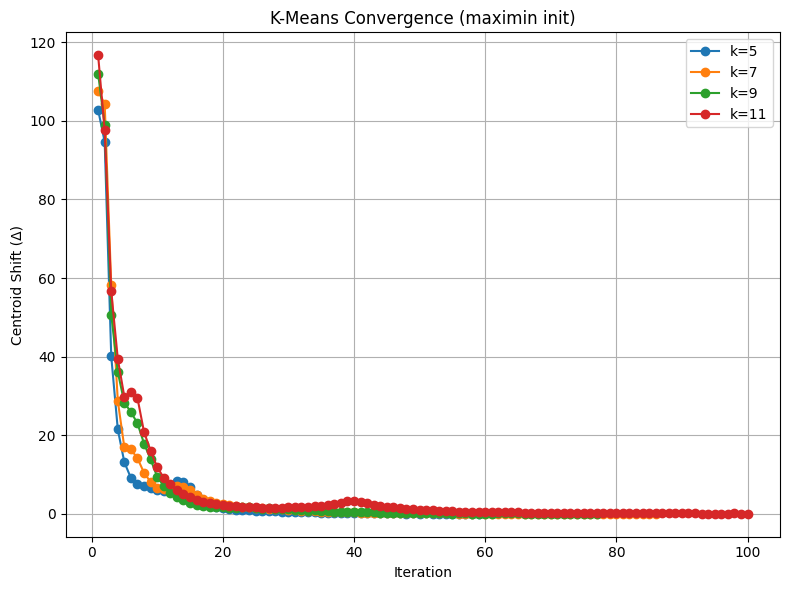

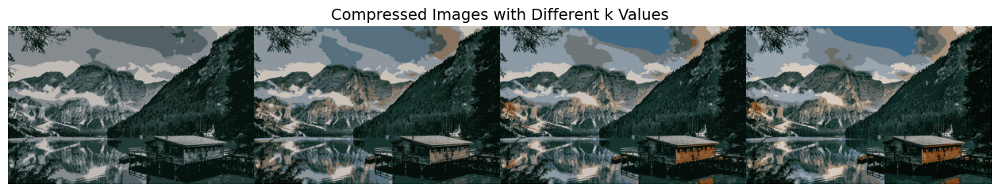

In [54]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# --- K-Means with convergence tracking ---
def kmeans_with_convergence_plot(img_1d, k_clusters, max_iter=100, init_centroids='random'):
    np.random.seed(42)



    if init_centroids == 'random':
        centroids = np.random.randint(0, 256, size=(k_clusters, img_1d.shape[1]))
    elif init_centroids == 'in_pixels':
        indices = np.random.choice(img_1d.shape[0], size=k_clusters, replace=False)
        centroids = img_1d[indices]
    elif init_centroids == 'kmeans++':
        centroids = initialize_centroids_kmeanspp(img_1d, k_clusters)
    elif init_centroids == 'maximin':
        centroids = initialize_centroids_maximin(img_1d, k_clusters)
    else:
        raise ValueError("Unknown init_centroids method.")

    deltas = []
    for _ in range(max_iter):
        distances = np.linalg.norm(img_1d[:, None] - centroids[None, :], axis=2)
        labels = np.argmin(distances, axis=1)
        new_centroids = np.array([
            img_1d[labels == i].mean(axis=0) if np.any(labels == i) else centroids[i]
            for i in range(k_clusters)
        ])
        delta = np.linalg.norm(centroids - new_centroids)
        deltas.append(delta)
        if np.allclose(centroids, new_centroids):
            break
        centroids = new_centroids

    return centroids.astype(np.uint8), labels, deltas

# --- Image utility functions ---
def read_img(img_path):
    return Image.open(img_path)

def convert_img_to_1d(img_2d):
    img = np.asarray(img_2d)
    h, w, c = img.shape
    return img.reshape(-1, c)

def generate_2d_img(img_2d_shape, centroids, labels):
    height, width, channels = img_2d_shape
    img_1d = centroids[labels]
    img_2d = img_1d.reshape((height, width, channels))
    return Image.fromarray(img_2d.astype(np.uint8))

def concat_images_horizontally(image_tuples):
    widths, heights = zip(*(img.size for _, img in image_tuples))
    total_width = sum(widths)
    max_height = max(heights)
    result = Image.new('RGB', (total_width, max_height))
    x_offset = 0
    for k, img in image_tuples:
        result.paste(img, (x_offset, 0))
        x_offset += img.size[0]
    return result

# --- Run experiment for multiple k values ---
img = read_img("assets/landscape-resize.jpg")
img_1d = convert_img_to_1d(img)
img_shape = np.asarray(img).shape

all_deltas = {}
result_images = []

for k in range(5, 12, 2):  # k = 5, 7, 9, 11
    centroids, labels, deltas = kmeans_with_convergence_plot(
        img_1d, k_clusters=k, max_iter=100, init_centroids='maximin'
    )
    all_deltas[k] = deltas
    new_img = generate_2d_img(img_shape, centroids, labels)
    result_images.append((k, new_img))

# --- Plot all convergence curves ---
plt.figure(figsize=(8, 6))
for k, deltas in all_deltas.items():
    plt.plot(range(1, len(deltas) + 1), deltas, marker='o', label=f'k={k}')
plt.title('K-Means Convergence (maximin init)')
plt.xlabel('Iteration')
plt.ylabel('Centroid Shift (Δ)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Show combined image of all results ---
combined_img = concat_images_horizontally(result_images)
# --- Show combined image of all results using matplotlib ---
plt.figure(figsize=(16, 8))
plt.imshow(combined_img)
plt.axis('off')
plt.title("Compressed Images with Different k Values", fontsize=14)
plt.show()

# Optional: Save to file
# combined_img.save("comparison_kmeans_results.png")

# Optionally save:
# combined_img.save("comparison_kmeans_results.png")


## Main FUNCTION

In [ ]:
def main():
    import os

    # Get image path from user input
    img_path = input("Enter the image file path (e.g., 'image.jpg'): ").strip()

    # Check if file exists
    if not os.path.exists(img_path):
        print("Image file not found. Please check the path.")
        return

    # Read and show the original image
    img = read_img(img_path)
    print("Original image:")
    show_img(img)

    # Convert to 1D
    img_1d = convert_img_to_1d(img)

    # Apply K-means
    k_clusters = 32
    max_iter = 100
    centroids, labels = kmeans(img_1d, k_clusters, max_iter, init_centroids='in_pixels')

    # Generate new image from clusters
    new_img = generate_2d_img(np.asarray(img).shape, centroids, labels)

    # Show the result
    print("Image after color quantization using K-means:")
    show_img(new_img)

    # Save image in both PNG and PDF formats
    base_name = os.path.splitext(os.path.basename(img_path))[0]
    output_png = f"{base_name}_kmeans.png"
    output_pdf = f"{base_name}_kmeans.pdf"

    save_img(new_img, output_png)
    save_img(new_img, output_pdf)

    print(f"Image saved as: '{output_png}' and '{output_pdf}'")


In [ ]:
# Call main function
main()